# Explore lnd_in file (surface data)

In [2]:
# mask the one beneath 60 degrees
# resolution of LPJ GUESS
# set titles and axis, title of the legend
# set caracter bigger
# bare ground? it dipends on the ice retrieve
# polynomial works for longitute? --> just tress btw
# metti lat in vert
# linea sul massimo emostra shift insieme a prec
# mwtti a posto natpdf domnant, no PCT_ etc
# perch esolo range 40-80?

In [3]:
# BOREAL NAT PDFs:
# - 0: Bare Ground
# - 2: NET Boreal
# - 3: NDT Boreal
# - 8: BDT Boreal
# - 11: BDS Boreal
# - 12: artic C3 grass
#Others:
# - 1: NET Temperate
# - 4: BET Tropical
# - 5: BET Temperate
# - 6: BDT Tropical
# - 7: BDT Temperate
# - 9: BES Temperate
# - 10: BDS Temperate
# - 13: C3 grass
# - 14: C4 grass

In [4]:
import numpy as np
import netCDF4 as nc
import xarray as xr
xr.set_options(display_style='html')
import cartopy
import cartopy.crs as ccrs
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import transforms
from matplotlib.colors import ListedColormap
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import proplot as pplt

import cartopy.feature as cfeature
import cartopy.crs as ccrs
import cartopy.mpl.ticker as cticker
from cartopy.util import add_cyclic_point
from owslib.wms import WebMapService
import os
from matplotlib.image import imread
import matplotlib.path as mpath
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

#### [Here are Markdown tips](https://towardsdatascience.com/enrich-your-jupyter-notebook-with-these-tips-55c8ead25255)
## <div class="alert alert-success">Import and prepare the dataset</div>

In [5]:
# Import surface data file: 
fn='../../data/surfdata_1.9x2.5_hist_16pfts_Irrig_CMIP6_simyr2000_c190304.nc'
dset_in = xr.open_dataset(fn)

In [6]:
# Explore the imported dataset with its variables etc...
dset_in
# It's a three dimensional dset:
# - time
# - cft: number of CropFT
# - natpft: number of PlantFT
# and other dimensions
# variables: https://noresm-docs.readthedocs.io/en/latest/output/clm_standard_out.html

<xarray.Dataset>
Dimensions:                  (lsmlat: 96, lsmlon: 144, nlevsoi: 10, natpft: 15, cft: 2, time: 12, lsmpft: 17, numurbl: 3, numrad: 2, nlevurb: 5, nglcecp1: 11, nglcec: 10)
Coordinates:
  * natpft                   (natpft) int32 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14
  * cft                      (cft) int32 15 16
  * time                     (time) int32 1 2 3 4 5 6 7 8 9 10 11 12
Dimensions without coordinates: lsmlat, lsmlon, nlevsoi, lsmpft, numurbl, numrad, nlevurb, nglcecp1, nglcec
Data variables: (12/81)
    mxsoil_color             int32 ...
    SOIL_COLOR               (lsmlat, lsmlon) int32 ...
    PCT_SAND                 (nlevsoi, lsmlat, lsmlon) float64 ...
    PCT_CLAY                 (nlevsoi, lsmlat, lsmlon) float64 ...
    ORGANIC                  (nlevsoi, lsmlat, lsmlon) float64 ...
    FMAX                     (lsmlat, lsmlon) float64 ...
    ...                       ...
    CONST_HARVEST_SH2        (lsmlat, lsmlon) float64 ...
    CONST_HARVEST_SH3        (lsmlat, lsmlon) float64 ...
    CONST_GRAZING            (lsmlat, lsmlon) float64 ...
    CONST_FERTNITRO_CFT      (cft, lsmlat, lsmlon) float64 ...
    UNREPRESENTED_PFT_LULCC  (natpft, lsmlat, lsmlon) float64 ...
    UNREPRESENTED_CFT_LULCC  (cft, lsmlat, lsmlon) float64 ...
Attributes: (12/50)
    Conventions:                          NCAR-CSM
    History_Log:                          created on: 03-04-19 21:18:11
    Logname:                              erik
    Host:                                 cheyenne3
    Source:                               Community Land Model: CLM5
    Version:                              release-clm5.0.18/gpfs/fs1/scratch/...
    ...                                   ...
    map_vic_file:                         map_0.9x1.25_GRDC_to_1.9x2.5_nomask...
    Soil_texture_raw_data_file_name:      mksrf_soitex.10level.c010119.nc
    Soil_color_raw_data_file_name:        mksrf_soilcolor_CMIP6_simyr2005.c17...
    Fmax_raw_data_file_name:              mksrf_fmax_3x3min_USGS_c120911.nc
    Organic_matter_raw_data_file_name:    mksrf_organic_10level_5x5min_ISRIC-...
    Vegetation_type_raw_data_filename:    mksrf_landuse_histclm50_LUH2_2000.c...

### <div class="alert alert-info">Comments:</div>
- check the version of the file: look in the attribute. Where there are all the source files where the values come from
- several isoprene - BVOC: `EF_*`
- also: albedo, PFT gross LULCC, LAI, other PFT related

In [7]:
#Set the longitude and latitude
dset_in['lsmlat'] = dset_in['LATIXY'].isel(lsmlon=0) #or dset_in['lsmlat'] = dset_in['lat']
dset_in['lsmlon'] = dset_in['LONGXY'].isel(lsmlat=0)

# Select PFT: percent plant functional type on the natural veg landunit (% of landunit)
# OBS! variable is centered, related to the ammount of land (full coloured even if )
dset_in = dset_in.rename({'lsmlat':'lat','lsmlon':'lon'})

#Convert longitude [0,360] -> [-180,180]
def convert360_180(ds):
    _ds = ds.copy()
    """
    Convert the longitude of the given xr:Dataset from [0-360] to [-180-180] deg
    """
    # check if already
    if np.min(_ds['lon'].values) >= 0:
        attrs = _ds['lon'].attrs
        _ds.coords['lon'] = (_ds.coords['lon'] + 180) % 360 - 180
        _ds = _ds.sortby(_ds.lon)
        _ds['lon'].attrs = attrs
        _ds.lon.attrs['valid_max'] = 180.0
        _ds.lon.attrs['valid_min'] = -180.0
    return _ds

dset_in=convert360_180(dset_in)
folder_out="data_out/"
dset_in.load().to_netcdf(folder_out+'dset_tot.nc')

# Land fraction based on PFT dataset
lnd_frac=dset_in.LANDFRAC_PFT
lnd_frac.load().to_netcdf(folder_out+'lnd_frac.nc')

# Select PFT: percent plant functional type on the natural veg landunit (% of landunit)
# OBS! variable is centered, related to the ammount of land (full coloured even if )
pfts = dset_in.PCT_NAT_PFT
dset_in.load().to_netcdf(folder_out+'pfts.nc')

pfts

<xarray.DataArray 'PCT_NAT_PFT' (natpft: 15, lat: 96, lon: 144)>
array([[[100.        , 100.        , 100.        , ..., 100.        ,
         100.        , 100.        ],
        [100.        , 100.        , 100.        , ..., 100.        ,
         100.        , 100.        ],
        [100.        , 100.        , 100.        , ...,  99.74730194,
         100.        , 100.        ],
        ...,
        [100.        , 100.        , 100.        , ..., 100.        ,
         100.        , 100.        ],
        [100.        , 100.        , 100.        , ..., 100.        ,
         100.        , 100.        ],
        [100.        , 100.        , 100.        , ..., 100.        ,
         100.        , 100.        ]],

       [[  0.        ,   0.        ,   0.        , ...,   0.        ,
           0.        ,   0.        ],
        [  0.        ,   0.        ,   0.        , ...,   0.        ,
           0.        ,   0.        ],
        [  0.        ,   0.        ,   0.        , ...,   0.        ,
           0.        ,   0.        ],
...
        [  0.        ,   0.        ,   0.        , ...,   0.        ,
           0.        ,   0.        ],
        [  0.        ,   0.        ,   0.        , ...,   0.        ,
           0.        ,   0.        ],
        [  0.        ,   0.        ,   0.        , ...,   0.        ,
           0.        ,   0.        ]],

       [[  0.        ,   0.        ,   0.        , ...,   0.        ,
           0.        ,   0.        ],
        [  0.        ,   0.        ,   0.        , ...,   0.        ,
           0.        ,   0.        ],
        [  0.        ,   0.        ,   0.        , ...,   0.25269806,
           0.        ,   0.        ],
        ...,
        [  0.        ,   0.        ,   0.        , ...,   0.        ,
           0.        ,   0.        ],
        [  0.        ,   0.        ,   0.        , ...,   0.        ,
           0.        ,   0.        ],
        [  0.        ,   0.        ,   0.        , ...,   0.        ,
           0.        ,   0.        ]]])
Coordinates:
  * natpft   (natpft) int32 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14
  * lat      (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float64 -180.0 -177.5 -175.0 -172.5 ... 172.5 175.0 177.5
Attributes:
    long_name:  percent plant functional type on the natural veg landunit (% ...
    units:      unitless

### <div class="alert alert-info">Comments:</div>
- convert Land Surface Coord into normal coord - <span style="color:gray">another JupNotebook on this topic</span>
- covert longitude from [0,360] to [-180, 180]: [eScience tips](https://nordicesmhub.github.io/forces-2021/learning/example-notebooks/some-xarray-pandas-presentation_Sara.html) and [here to `sortby('lon')`](https://stackoverflow.com/questions/53121089/regridding-coordinates-with-python-xarray). My version also makes a copy, orders, keeps the attributes.
- save Dataset Xarray **to netcdf files**: `.load().to_netcdf` (following [eScience tips](https://nordicesmhub.github.io/forces-2021/learning/example-notebooks/save_to_forces_bucket.html))

## <div class="alert alert-success">List of PFTs</div>

| **natpft** | **napft_name**  |
|------------|-----------------|
| **0**      | Bare Ground     |
| **1**      | Temperate NET   |
| **2**      | Boreal NET      |
| **3**      | Boreal NDT      |
| **4**      | Tropical BET    |
| **5**      | Temperate BET   |
| **6**      | Tropical BDT    |
| **7**      | Temperate BDT   |
| **8**      | Boreal BDT      |
| **9**      | Temperate BES   |
| **10**     | Temperate BDS   |
| **11**     | Boreal BDS      |
| **12**     | Arctic C3 grass |
| **13**     | C3 grass        |
| **14**     | C4 grass        |

In [8]:
pft_names = {0:'Bare Ground', 1:'TeNET', 2:'BoNET', 3:'BoNDT', 4:'TrBET', 5:'TeBET', 6:'TrBDT', 
             7:'TeBDT', 8:'BoBDT', 9:'TeBES', 10:'TeBDS', 11:'BoBDS', 12:'arcticC3', 13:'C3', 14:'C4'}
pft_bg = [0]
pft_grass = [12,13,14]
pft_shrubs = [9,10,11]
pft_trees = [1,2,3,4,5,6,7,8]

## <div class="alert alert-success">Maps – overview on PFTs</div>
<span style="color:red"> **OBS! FILTER OVER THE OCEAN**: when evaluating the mean I consider **0 land** without that PFT and **NaN the ocean**. </span>

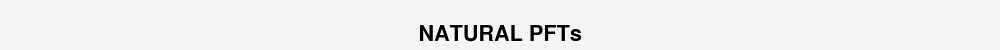

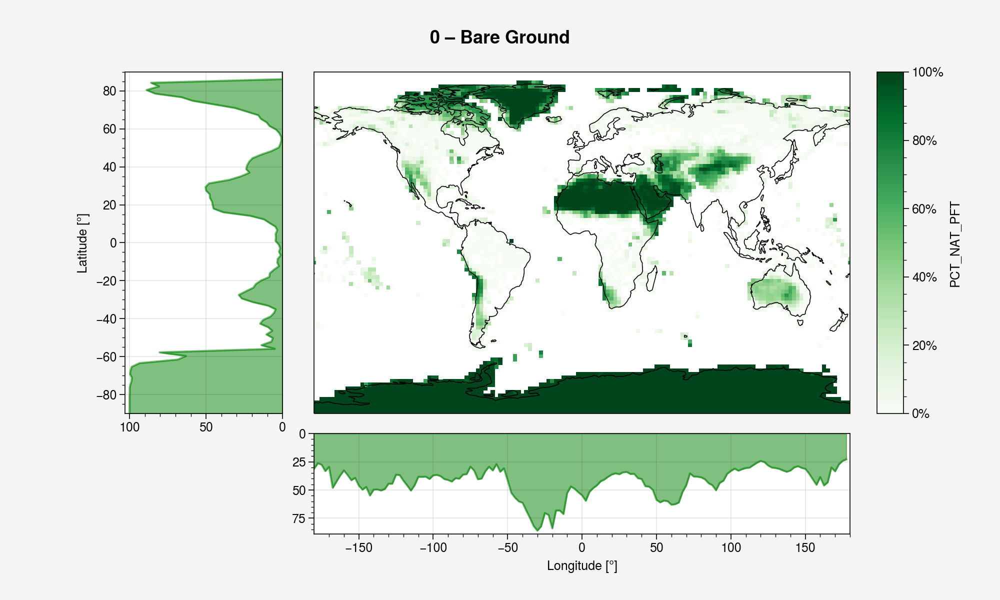

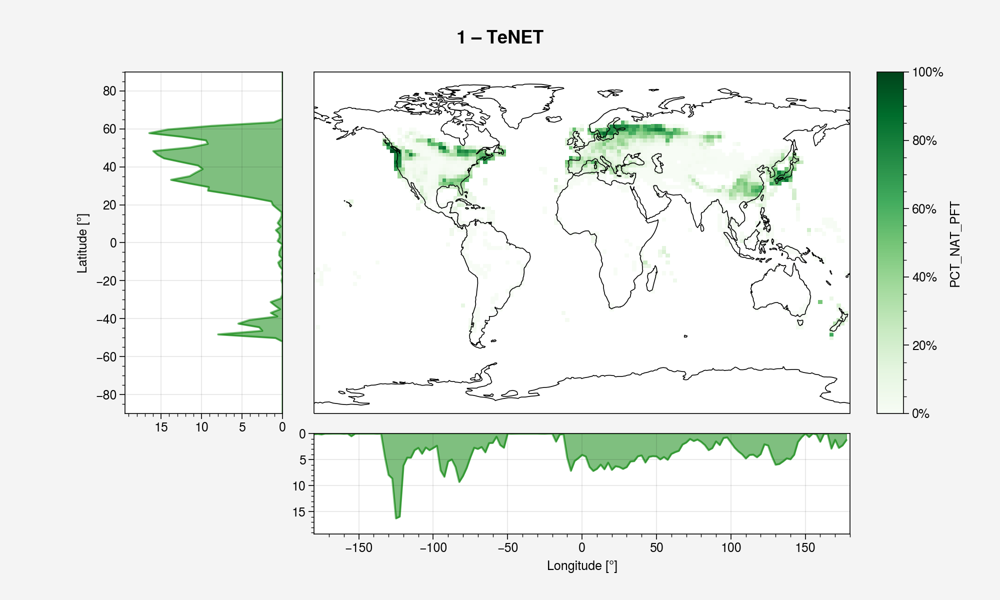

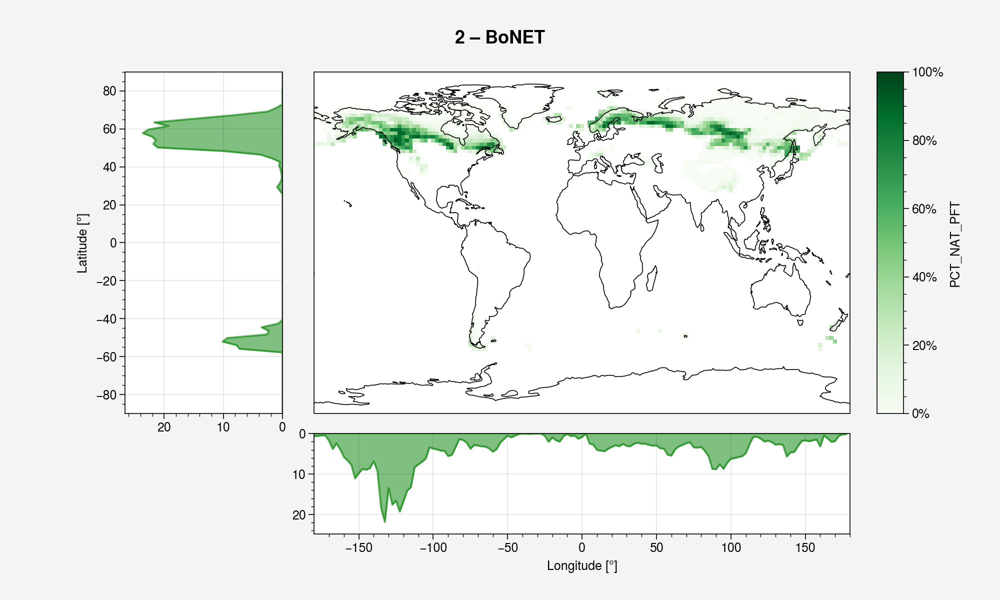

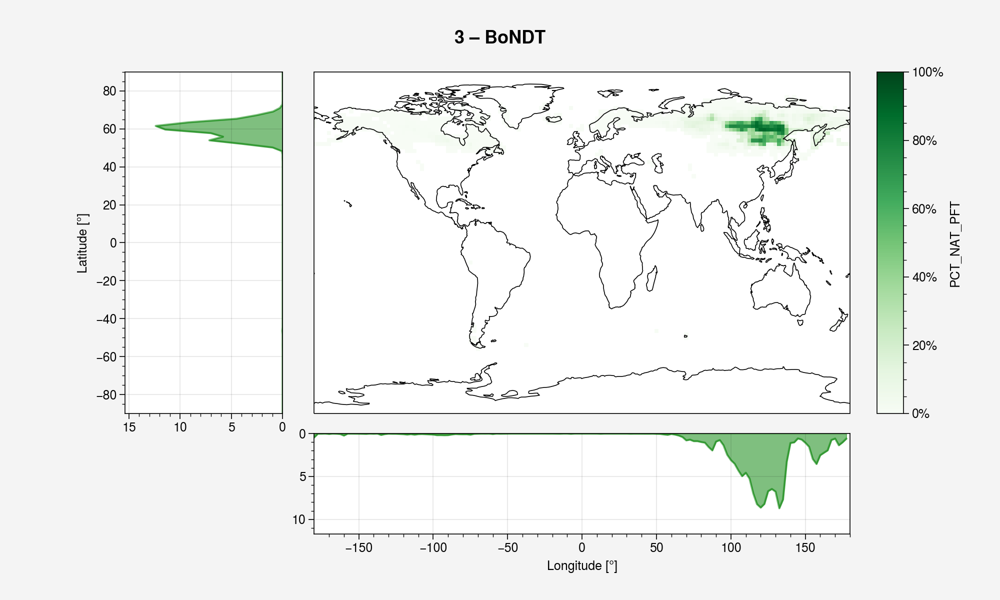

...

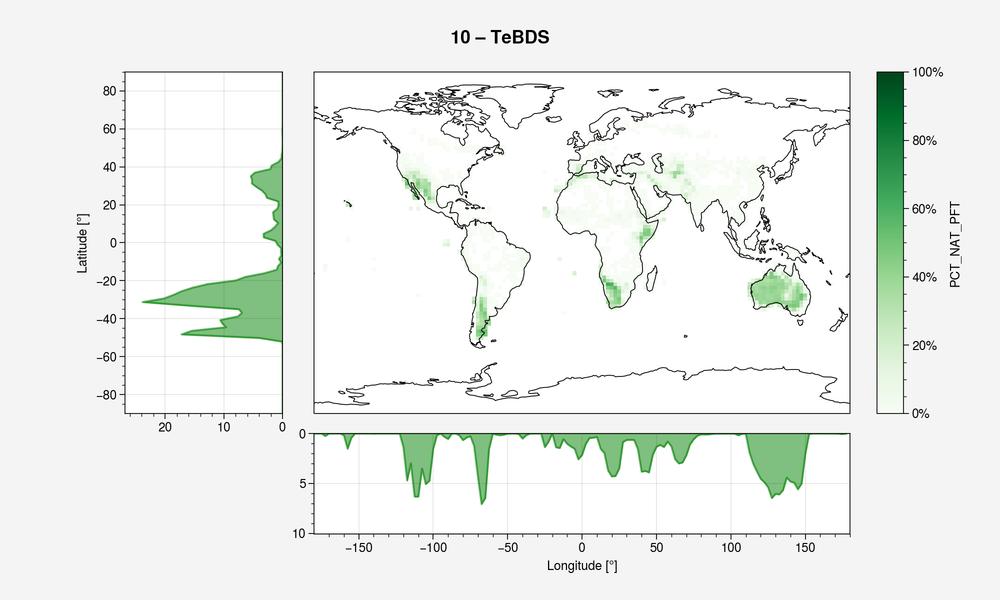

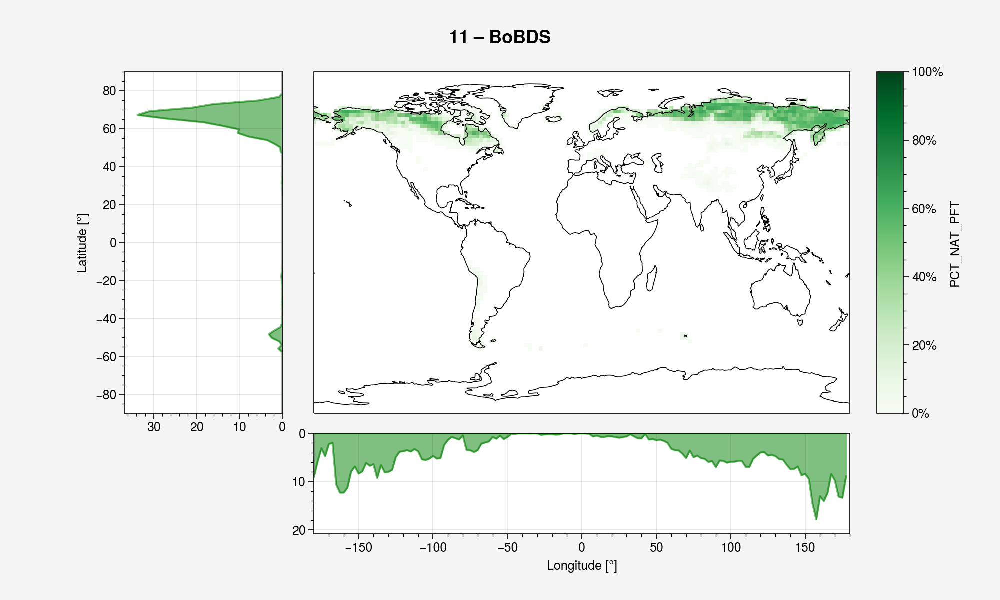

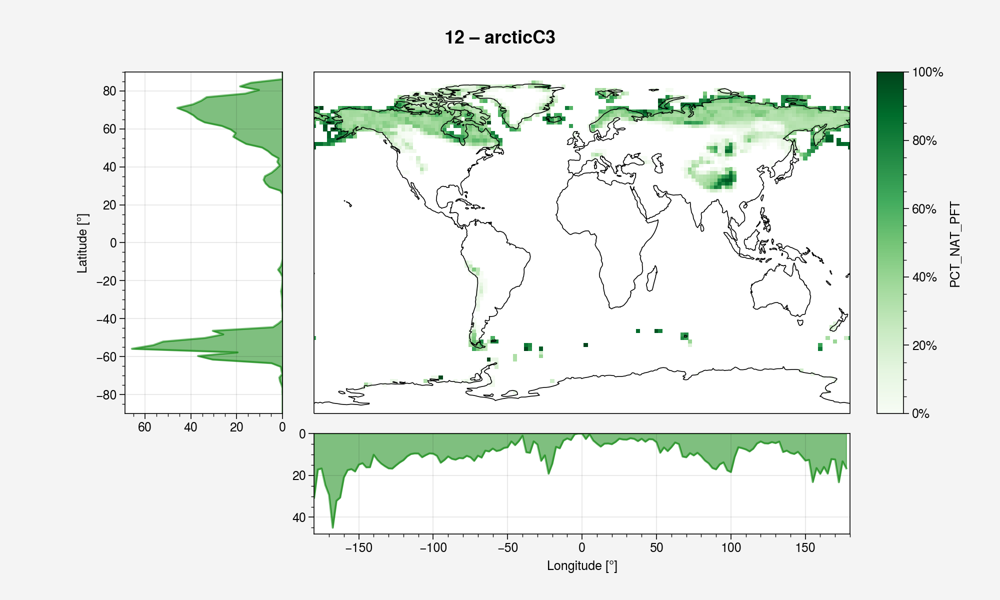

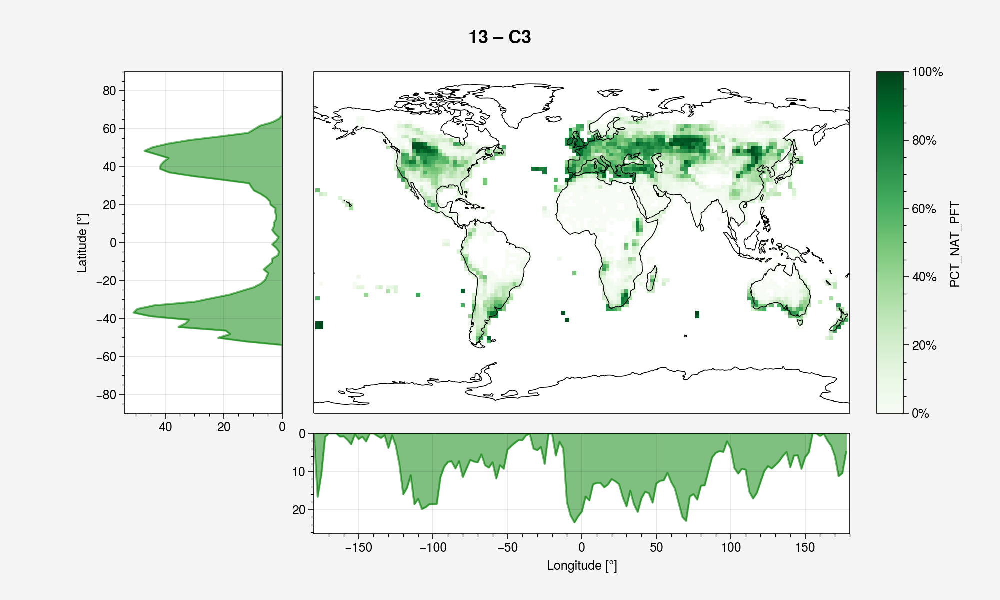

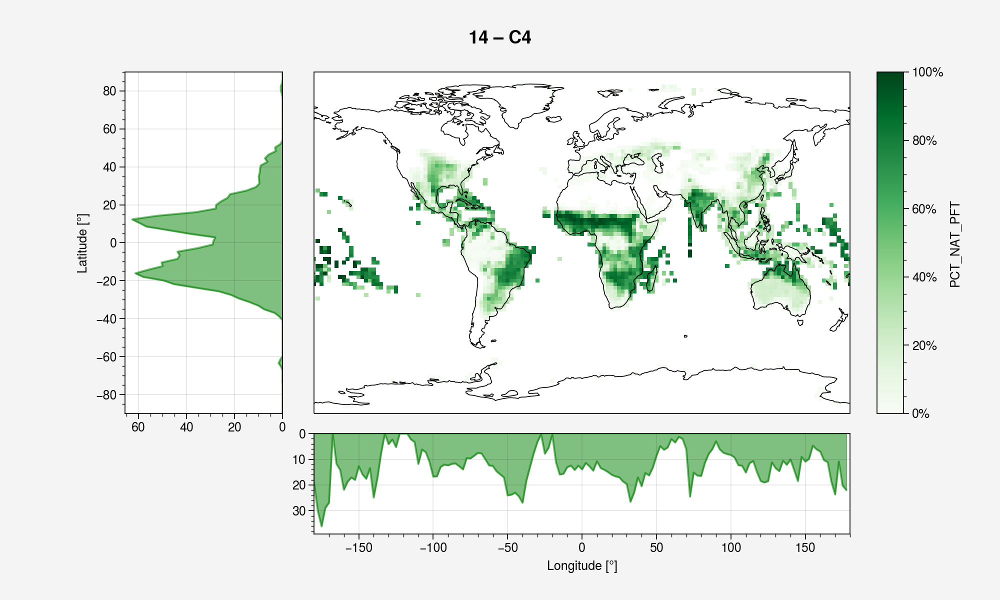

In [9]:
pfts = pfts.where(lnd_frac>0.)
# Preparing side plots, averaging over lat and lon
# Note: mean(), because it's a percentage, already a measure of distribution
pfts_lat = pfts.mean('lon')
pfts_lon = pfts.mean('lat')

# Fancy title
fig = plt.figure(figsize=(10, 0.5))
grid = plt.GridSpec(1, 1)
ax = fig.add_subplot(grid[:, :])
ax.axis('off')
plt.suptitle('NATURAL PFTs', weight='bold', size='xx-large', y=0.5)
plt.tight_layout()
plt.show()


for n in range(0,14+1):
    fig = plt.figure(figsize=(10, 6))
    grid = plt.GridSpec(4, 4, hspace=0.2, wspace=0.2, right=0.85)
    
    ####### Main map:
    main_ax = fig.add_subplot(grid[:-1, 1:], projection=ccrs.PlateCarree())
    main_ax.set_global()
    main_ax.coastlines()
    main_ax.set_aspect('auto')
    im = pfts.where(pfts>0.).drop('natpft').sel(natpft=n).plot(ax=main_ax, add_colorbar=False, cmap='Greens', vmin = 0, vmax =100)
    plt.suptitle(str(n)+' – '+pft_names[n], weight='bold', size='x-large', y=0.95) #main_ax.set_ #'natpft = '+ 

    ####### Latitude plot:
    # It was hard to have an area but orientated vertically (hist has orientation, line is easy, area is hell)
    lat_ax = fig.add_subplot(grid[:-1, 0], sharey=main_ax, ylabel='Latitude [°]') #xticklabels=[],
    df = pfts_lat.sel(natpft=n).drop('natpft').rename('Latitude [°]').to_series().rename_axis('')
    base = plt.gca().transData
    rot = transforms.Affine2D().rotate_deg(90)
    reflect_vertical = transforms.Affine2D(np.array([[1, 0, 0], [0, -1, 0], [0, 0, 1]]))
    df.plot(kind='area', ax=plt.gca(),transform= reflect_vertical + rot + base, stacked=False, color='g',xlim=(0, pfts_lat.sel(natpft=n).max()+3), ylim=(-90,90))
    plt.gca().invert_xaxis() #same as lat_ax.invert_xaxis()

    #this is if just a line as plot, but I did want to have an area... much more work..
    #pfts_lat.sel(natpft=n).T.to_series().plot(y='lat',ax=lat_ax)

    ####### Longitude plot:
    lon_ax = fig.add_subplot(grid[-1, 1:], sharex=main_ax) #yticklabels=[], 
    pfts_lon.sel(natpft=n).to_series().rename_axis('Longitude [°]').plot(kind='area', ax=lon_ax, stacked=False, color='g', ylim=(0,pfts_lon.sel(natpft=n).max()+3))
    lon_ax.invert_yaxis()
    
    ####### Colorbar:
    axins = inset_axes(lon_ax, # here using axis of the lowest plot
               width="5%",  # width = 5% of parent_bbox width
               height="340%",  # height : 340% good for a (4x4) Grid
               loc='lower left',
               bbox_to_anchor=(1.05, 1.2, 1, 1),
               bbox_transform=lon_ax.transAxes,
               borderpad=0
               )

    cb = fig.colorbar(im, cax=axins,format='%.0f%%', label = 'PCT_NAT_PFT')
    
    plt.tight_layout()
    plt.show()

### <div class="alert alert-info">Comments:</div>
- `GridSpec`: maps + lon/lat distribution + colorbar in a single plot. Here is [documentation](https://matplotlib.org/stable/api/_as_gen/matplotlib.gridspec.GridSpec.html) and [user guide](https://matplotlib.org/stable/tutorials/intermediate/arranging_axes.html) and [inspiration for this one](https://www.oreilly.com/library/view/python-data-science/9781491912126/ch04.html)-> need to deepen the order of the spec
- add the colorbar to `GridSpec` - here is the [recipe](https://matplotlib.org/3.1.1/gallery/axes_grid1/demo_colorbar_with_inset_locator.html) 
- set colorbar limits: `vim` and `vmax`
- change format colorbar ticks - percentage: `format='%.0f%%'`. Other arguments [here](https://matplotlib.org/3.1.1/api/_as_gen/matplotlib.pyplot.colorbar.html) and to have the percentage format (from 0.1 -> 10%) [here](https://stackoverflow.com/questions/34820239/seaborn-heatmap-colorbar-label-as-percentage).
- `main_ax.set_aspect('auto')` rescales the rigid `ccrs.PlateCarree()`
- remember to filter NaN values, in the mean can lead to mistakes
- plot a [vertical oriented area chart](https://stackoverflow.com/questions/50802556/how-to-plot-a-vertical-area-plot-with-pandas) (mission impossible completed ✅). Note: `stacked=False` 
- `plt.gca()` means [*get corrent axis*](https://stackoverflow.com/questions/45381589/how-does-plt-gca-work-internally)
- Empty axis: `ax.axis('off')` or `ax.set_visible(False)` hide the axis already created
- Invert axis: `ax.invert_yaxis()`
- Rename a series: `.rename_axis(name)`

## <div class="alert alert-success">Select PFTs in the boreal zone</div>

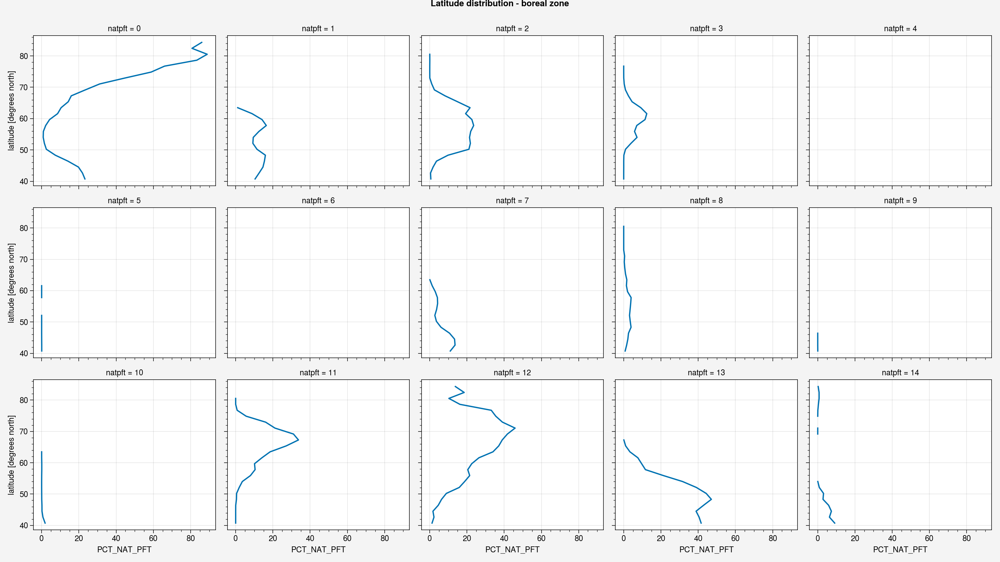

In [10]:
boreal_lat = 45.
#taken from LPGJ_GUESS paper
boreal_lat = 48.
#https://www.researchgate.net/publication/280530183_The_Boreal_Climate
boreal_lat = 40.
#to be conservative and look at the sub-boreal as well

c = pfts.sel(lat=slice(boreal_lat,90)).mean('lon')
c=c.where(c>0.)
c.plot(y='lat',col='natpft', col_wrap=5)
plt.suptitle("Latitude distribution - boreal zone", y=1)
plt.tight_layout()
plt.show()
#c=c.fillna(0.)

###### Longitude distribution:###########
#c = pfts.where(pfts.lat>boreal_lat).dropna('lat', how='all').mean('lat')
#c.where(c>0.).plot(col='natpft', col_wrap=3)
#plt.suptitle("Longitude distribution - boreal zone", y=1)
#plt.tight_layout()
#plt.show()

The 0 values were subsitute by NaN values to highlight the absence of each PFT.

From these plots we see:
- BOREAL: 0,2,3,11,12
- BOREAL but little relevant: 8
- NOT BOREAL but can contribute ("SUB_BOREAL"): 1,7,13

In [11]:
# BOREAL NAT PDFs:
# - 0: Bare Ground
# - 2: NET Boreal
# - 3: NDT Boreal
# - 8: BDT Boreal
# - 11: BDS Boreal
# - 12: artic C3 grass
#Others:
# - 1: NET Temperate
# - 4: BET Tropical
# - 5: BET Temperate
# - 6: BDT Tropical
# - 7: BDT Temperate
# - 9: BES Temperate
# - 10: BDS Temperate
# - 13: C3 grass
# - 14: C4 grass

# BOREAL PFTs:
bpft_names_tot = {0:'Bare Ground', 2:'BoNET', 3:'BoNDT', 8:'BoBDT', 11:'BoBDS', 12:'arcticC3'}
bpft_names = {2:'BoNET', 3:'BoNDT', 8:'BoBDT', 11:'BoBDS', 12:'arcticC3'}
bpft_bg = [0]
bpft_grass = [12]
bpft_shrubs = [11]
bpft_trees = [2,3,8]
bpfts = bpft_trees+bpft_shrubs+bpft_grass
bpfts_tot = bpft_bg+bpfts

# SUB BOREAL PFTs:
sbpft_names = {1:'TeNET', 7:'TeBDT', 13:'C3'}
sbpft_grass = [13]
sbpft_trees = [1,7]


sbpfts = bpfts+sbpft_grass+sbpft_trees
sbpfts.sort()

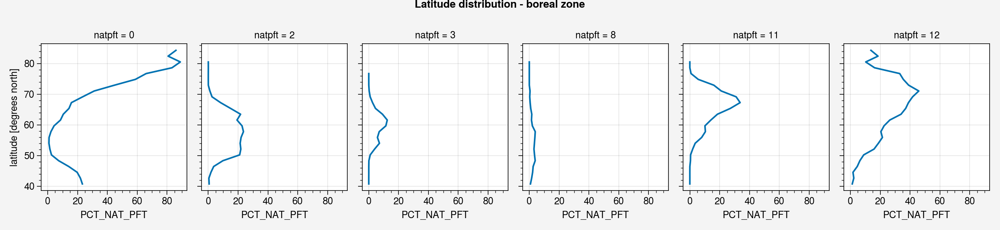

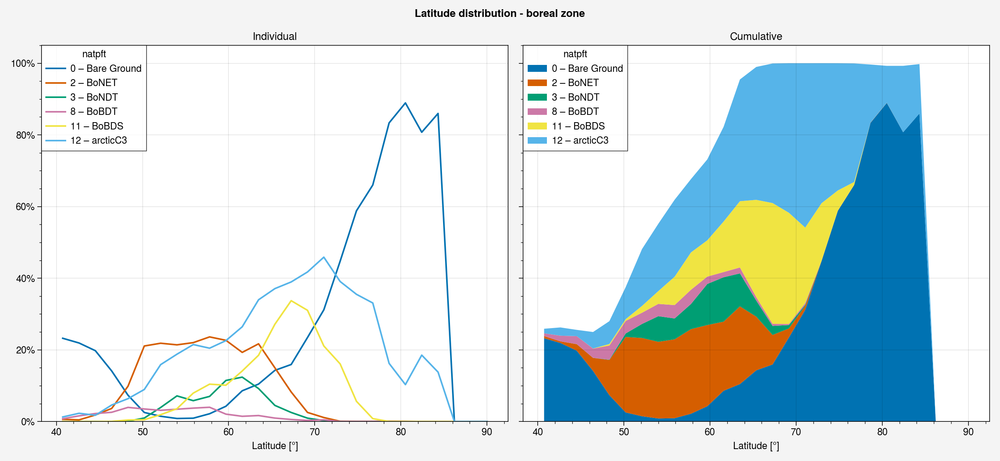

In [12]:
def dict_to_legend(dct):
    return ["{} – {}".format(item, amount) for item, amount in dct.items()]

bc = c.sel(natpft=bpfts_tot)
bc.plot(y='lat',col='natpft', figsize=[13,3])
plt.suptitle("Latitude distribution - boreal zone", y=1)
plt.tight_layout()
plt.show()

bc = bc.fillna(0.)
fig, axes = plt.subplots(1,2,figsize=(13, 6), sharex= True, sharey=True)
bc.T.to_series().unstack().plot(ax=axes[0], stacked=False, title="Individual") #plot.area
axes[0].legend(dict_to_legend(bpft_names_tot), title='natpft')

axes[1].stackplot(bc.lat, bc)
axes[1].legend(dict_to_legend(bpft_names_tot), title='natpft', loc='upper left')
axes[1].set_title("Cumulative")

for b, ax in enumerate(axes.flat):
    vals = ax.get_yticks()
    ax.set_yticklabels(['{0:g}%'.format(x) for x in vals])
    ax.set_xlabel("Latitude [°]")
    #ax.set_xlim(40,84)

plt.suptitle("Latitude distribution - boreal zone")

plt.tight_layout()
plt.show()

### <div class="alert alert-info">Comments:</div>
- *Dictionary*: `.keys()`, `.values()`, `.item()`, `.ammount()`. Here [examples](https://www.w3schools.com/python/python_dictionaries_access.asp) of accessing dicts.
- format use and fancy legend
- `FacetGrid` is seaborn functionality, you can pass directly `figsize` or `add_titles`. Here [documentation](https://docs.xarray.dev/en/stable/generated/xarray.plot.FacetGrid.html)
- set figure parameters: `plt.rcParams["figure.figsize"] = (20,10)`. Here [all parameters](https://matplotlib.org/stable/tutorials/introductory/customizing.html) one can set a posteriori.

## Bare Ground: yes or no?

Filter just bareground on land (`dset_in.LANDFRAC_PFT`).

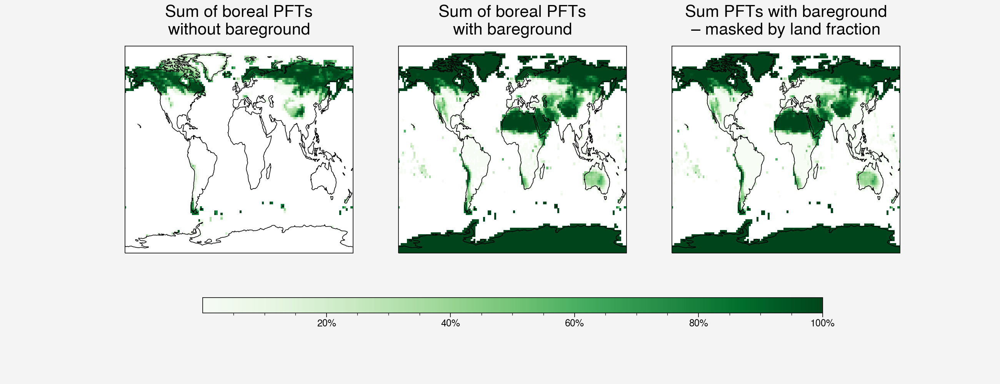

In [13]:
fig, axes = plt.subplots(1,3,figsize=(13, 5), sharex= True, sharey=True, subplot_kw=dict(projection=ccrs.PlateCarree()))

pfts_b=pfts.sel(natpft=bpfts)
pfts_b_sum = pfts_b.sum('natpft', keep_attrs=True)
p=pfts_b_sum.where(pfts_b_sum>0.).plot.pcolormesh(ax=axes[0], add_colorbar=False, cmap='Greens')
axes[0].set_title("Sum of boreal PFTs\nwithout bareground",y=1.03, size='xx-large')

pfts_b=pfts.sel(natpft=bpfts_tot)
pfts_b_sum = pfts_b.sum('natpft', keep_attrs=True)
pfts_b_sum.where(pfts_b_sum>0.).plot.pcolormesh(ax=axes[1],add_colorbar=False, cmap='Greens')#,transform=ccrs.PlateCarree())
axes[1].set_title("Sum of boreal PFTs\nwith bareground",y=1.03, size='xx-large')

pfts_b_sum.where(lnd_frac>0.).plot.pcolormesh(add_colorbar=False, cmap='Greens', ax=axes[2])
axes[2].set_title("Sum PFTs with bareground\n– masked by land fraction",y=1.03, size='xx-large')


for b, ax in enumerate(axes.flat):
    ax.set_global()
    ax.coastlines()
    ax.set_aspect('auto')

fig.colorbar(p, ax=axes.ravel().tolist(), location = 'bottom', shrink=0.8, aspect=40,format='%.0f%%')
    
plt.tight_layout()
plt.show()

### Create boreal datasets to work on : select boreal pfts and boreal region

<span style="color:red">For a first analysis, **I will consider no bareground**, but all ready to be included.</span>

Create 3 datasets:
- Boreal PFTs: `boreal_pfts`
- Boreal BG: `boreal_bg`
- Sub Boreal PFTs: `subboreal_pfts`

*Filter*: NaN values on ocean, 0. values on land

In [14]:
def select_boreal_region(dset, npft, boreal_lat, lnd_frac):
    """Filter the boreal region (above boreal_lat) and select the boreal PFTs. 
    This function specifically needs land_frac to filter, but it can be edited more general."""
    
    br = dset.sel(natpft=npft).where(lnd_frac>0.)
    br = br.sel(lat=slice(boreal_lat,90))#where(br.lat>boreal_lat)#.dropna('lat', how='all')
    return br

boreal_pfts=select_boreal_region(pfts, npft=bpfts, boreal_lat=boreal_lat, lnd_frac=lnd_frac)
boreal_bg=select_boreal_region(pfts, npft=0, boreal_lat=boreal_lat, lnd_frac=lnd_frac)
subboreal_pfts=select_boreal_region(pfts, npft=sbpfts, boreal_lat=boreal_lat, lnd_frac=lnd_frac)

boreal_pfts.load().to_netcdf(folder_out+'boreal_pfts.nc')
boreal_bg.load().to_netcdf(folder_out+'boreal_bg.nc')
subboreal_pfts.load().to_netcdf(folder_out+'subboreal_pfts.nc')

### <div class="alert alert-danger"> Open challenge: make subboreal </div>
Idea: natpft is the union of bpft, sbpft : (bpft, sbpft). but I'm way too tired today.

I know it's possible: like in dset in lsmpft.

Some websites:
- https://docs.xarray.dev/en/stable/generated/xarray.combine_by_coords.html
- https://stackoverflow.com/questions/39626402/add-dimension-to-an-xarray-dataarray
- https://docs.xarray.dev/en/v0.9.2/reshaping.html
- https://docs.xarray.dev/en/stable/user-guide/data-structures.html
- https://docs.xarray.dev/en/stable/generated/xarray.concat.html#xarray.concat

In [15]:
#subbpfts=sbpft_trees+sbpft_grass #subbpfts.sort()
#sb1=select_boreal_region(pfts, npft=subbpfts, boreal_lat=boreal_lat, lnd_frac=lnd_frac)

#subboreal_pfts=xr.merge([boreal_pfts.rename('PCT_BOR_PFT').rename(natpft='bpft'),sb1.rename('PCT_SUBBOR_PFT').rename(natpft='sbpft')], compat='override')
#subboreal_pfts.expand_dims("natpft", ['bpft','sbpft'])

#bp1=boreal_pfts.rename('PCT_BOR_PFT').rename(natpft='bpft')
#sb2=sb1.rename('PCT_SUBBOR_PFT').rename(natpft='sbpft')
#c=xr.merge([bp1,sb2])
#c['PCT_NAT_PFT']=xr.merge([bp1,sb2], ('lon','lat'))

#xr.merge([subboreal_pfts.set_index(sbpft='natpft'),boreal_pfts.set_index(bpft='natpft')])
#xr.merge([boreal_pfts.rename(natpft='bpft'),boreal_pfts], compat='override')
#subboreal_pfts.set_index(sbpft='natpft')

## <div class="alert alert-success">Boreal PFTs maps</div>

In [16]:
def ax_map_properties(ax):
    ax.coastlines()
    ax.gridlines()
    ax.add_feature(cartopy.feature.OCEAN, zorder=0, alpha=0.3)
    ax.add_feature(cartopy.feature.LAND, edgecolor='black')
    ax.add_feature(cfeature.BORDERS, alpha=0.3)
    ax.add_feature(cfeature.RIVERS)
    #ax.stock_img()
    return ax

def cut_Orthographic(lat=40):
    """Return circle where to cut the circular plot, given the latitude"""
    ax.set_extent([-180,180, lat,90], crs = ccrs.PlateCarree())
    # Compute a circle in axes coordinates, which we can use as a boundary for the map. 
    # We can pan/zoom as much as we like - the boundary will be permanently circular.
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    return circle

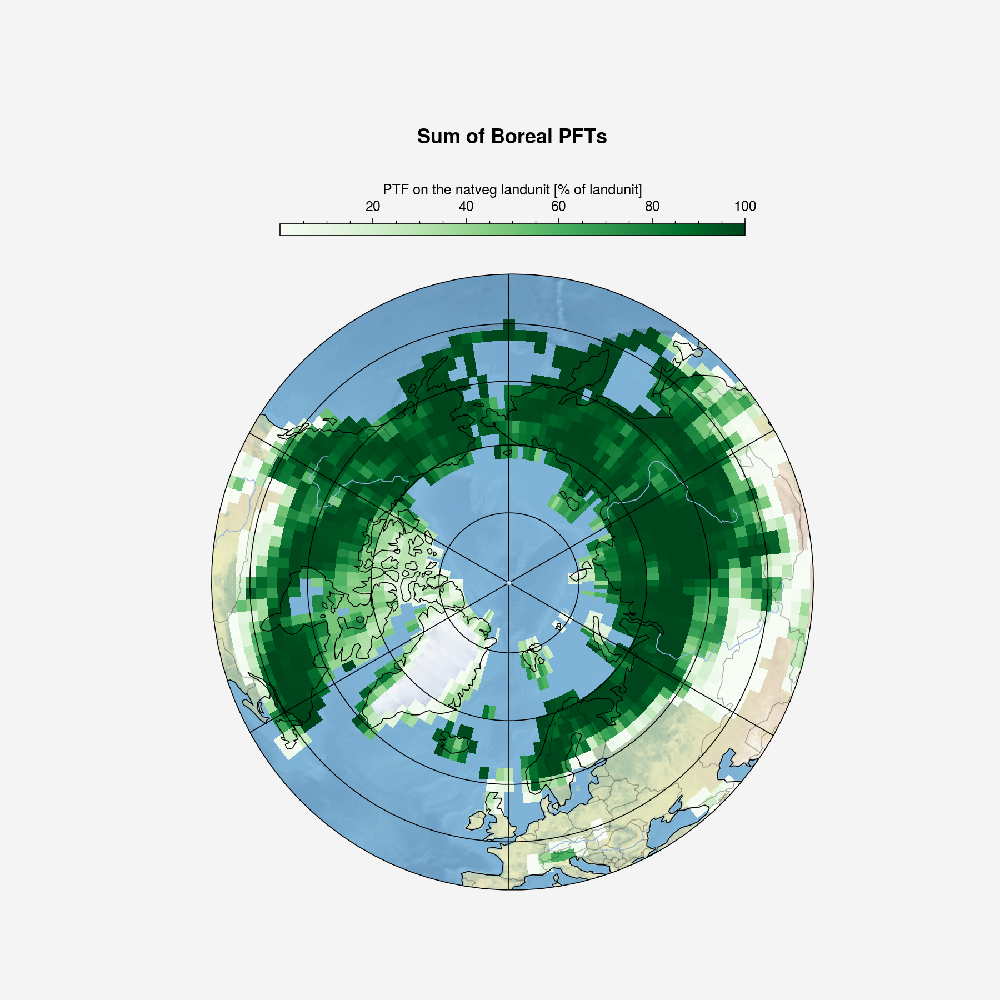

In [17]:
#Note: this is the cleaned version of the plot code, to check the various changes 
# (possibilities for other changes of the plot), just look at the bottom of the notebook

boreal_pfts_sum = boreal_pfts.sum('natpft', keep_attrs=True)
boreal_pfts_sum = boreal_pfts_sum.where(boreal_pfts_sum>0.)

fig = plt.figure(1, figsize=[9,9])#,dpi=100)
ax = plt.axes(projection=ccrs.Orthographic(0, 90))

#### ZOOM ON THE MAP : cut over boreal_lat = 40 #############
######### Opposite of ax.set_global()
circle = cut_Orthographic(boreal_lat)
ax.set_boundary(circle, transform=ax.transAxes)
##############################################################

p = boreal_pfts_sum.plot.pcolormesh(ax=ax, x='lon', y='lat', cmap='Greens', vmax=100,transform=ccrs.PlateCarree(), 
                                    add_colorbar=False) #cbar_kwargs={'orientation': 'horizontal', 'shrink':0.6, 'aspect':40})#,"pad": 1.1})
cbar = plt.colorbar(p,ax = [ax], location = 'top', shrink=0.6, aspect=40, label='PTF on the natveg landunit [% of landunit]')


###### COSTUM PLOT w/ FEAUTURES ############
ax = ax_map_properties(ax)
#ax.add_feature(provinces_50m) #check at the end what province_50m is

##### More Earth details: [look at the end with NASA images]
ax.stock_img()
##### Simple fautures:
#ax.add_feature(cartopy.feature.OCEAN, zorder=0, alpha=0.3)
#ax.add_feature(cartopy.feature.LAND, zorder=0, edgecolor='black', alpha=0.3)

ax.set_title("Sum of Boreal PFTs",y=1.2,size='x-large', weight='bold') #, y=1.15, 
plt.tight_layout()

#ax.set_position([0.05, 0.05, 0.5, 0.5])
#plt.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.9, wspace=0.05, hspace=0.05)
#ax.set_aspect(1)#'auto')

plt.show()

Note: `contourf` is prettier but less accurate than `pcolormesh`

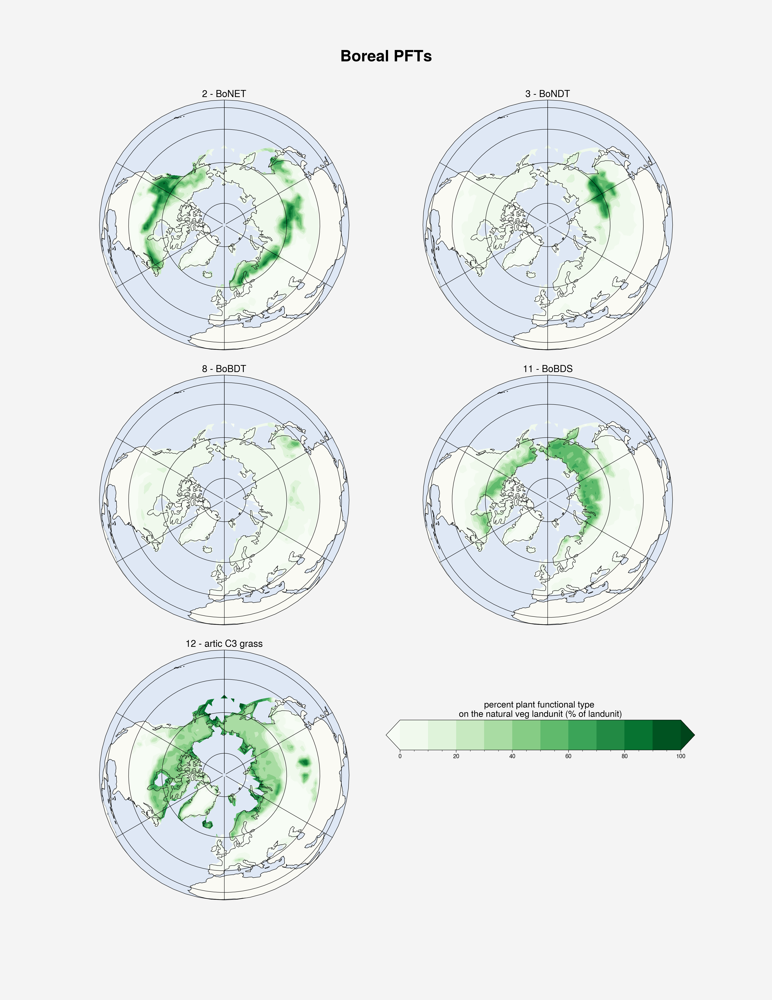

In [18]:
proj = ccrs.PlateCarree()
map_proj = ccrs.Orthographic(0, 90)

titles=['2 - BoNET','3 - BoNDT','8 - BoBDT','11 - BoBDS','12 - artic C3 grass']
#plt.tight_layout()
p=boreal_pfts.plot.contourf(x='lon', y='lat', col='natpft', col_wrap=2,
                              cmap='Greens', transform=proj, 
                              subplot_kws={'projection':map_proj},
                              add_colorbar=False,figsize=(17, 22), robust=False)


for i, ax in enumerate(p.axes.flat):
    ax.coastlines()
    ax.gridlines()
    ax.add_feature(cartopy.feature.OCEAN, zorder=0, alpha=0.3)
    ax.add_feature(cartopy.feature.LAND, zorder=0, edgecolor='black', alpha=0.3)
    if i<5: 
        ax.set_title(titles[i])
        data,lons=add_cyclic_point(boreal_pfts.isel(natpft=i).values,coord=boreal_pfts['lon'])
        cs=ax.contourf(lons,boreal_pfts['lat'],data, transform = proj, 
                            cmap ='Greens', extend='both', levels = np.linspace(0,100, 11) )
    ax.title.set_size(15)
    ax.title.set_position([0.5,1.5])

plt.tight_layout()
plt.subplots_adjust(bottom=0.1, top=0.9, left=0.1, right=0.9, wspace=0.1, hspace=0.1)
cbar_ax = p.fig.add_axes([0.5, 0.25, 0.4, 0.03]) #[left, bottom, width, height]
cbar=p.fig.colorbar(cs,cax=cbar_ax ,orientation='horizontal')
cbar.ax.set_title('percent plant functional type \non the natural veg landunit (% of landunit)', size = 14 )

plt.suptitle("Boreal PFTs", size=25, y = 0.95, fontweight = 'bold')
plt.show()

### <div class="alert alert-info">Comments:</div>
- cut an area of the map: `ax.set_extent([-180,180, 40,90], crs = ccrs.PlateCarree())`
- Cut Orthographic projection: Here the [code](https://scitools.org.uk/cartopy/docs/latest/gallery/lines_and_polygons/always_circular_stereo.html#sphx-glr-gallery-lines-and-polygons-always-circular-stereo-py).
- change title properties of an axis: `ax.title.set_size(15)` and `ax.title.set_position([0.5,1.5])`. Here [doc](https://matplotlib.org/3.1.1/api/_as_gen/matplotlib.axes.Axes.set_position.html). Where with `plt.rc('font', size=SMALL_SIZE)` you change the default settings.

## <div class="alert alert-success">Dominant vegetation </div>

In [19]:
def dominant_vegetation(veg_ds, pfts_list):
    """
    Create DataArray with .values() as the corresponding PFTs number
    """
    # Start copying the first PFT, fill the array of respective PFT number and filter by lnd_frac
    dominant_veg = veg_ds.isel(natpft=0).copy()
    dominant_veg[:] = pfts_list[0]
    dominant_veg = dominant_veg.where(veg_ds.sel(natpft=pfts_list[0])>0.).drop('natpft')
    #dominant_veg.plot(); plt.show()

    # Building the dominant veg rappresentation: 
    # find max PFT value in each grid cell and compare to each "layer" of PFT 
    # -> if equal to the max, then substitute the PFT number with the new max PFT number
    pfts_max = veg_ds.max(dim='natpft')
    pfts_max=pfts_max.where(pfts_max>0.)
    #pfts_max.plot(); plt.show()

    for p in range(len(pfts_list)):
        pft_filter=veg_ds.sel(natpft=pfts_list[p]) == pfts_max 
        # pft_filter is a True-False array (where -lat/lon- is equal to max values)
        pft_filter=pft_filter
        dominant_veg = xr.where(pft_filter, pfts_list[p], dominant_veg) 
        # where True, PFT number. Otherwise keep dominant veg value

        dominant_veg = dominant_veg.drop('natpft').rename('PFTs')
    return dominant_veg

def discrete_mapping_elements(col_dict, labels):
    """Return colormap, normalizer, format and ticks for colorbar in order to plot a discrete map
        Args:
            - col_dict (dictionary): dictionary with values as .keys() and respective color as .items()
            - labels (list of strings): names relative to values"""
    # Create a colormap
    cm = ListedColormap([col_dict[x] for x in col_dict.keys()])
    # Normalizer:
    ## Prepare bins for the normalizer
    norm_bins = np.sort([*col_dict.keys()]) + 0.5
    norm_bins = np.insert(norm_bins, 0, np.min(norm_bins) - 1.0)
    ## Make normalizer and formatter
    norm = matplotlib.colors.BoundaryNorm(norm_bins, len(labels), clip=True)
    fmt = matplotlib.ticker.FuncFormatter(lambda x, pos: labels[norm(x)])
    # Create ticks to have equidistance between ticks
    diff = norm_bins[1:] - norm_bins[:-1]
    tickz = norm_bins[:-1] + diff / 2
    return cm, norm, fmt, tickz

## Dominant boreal PFTs

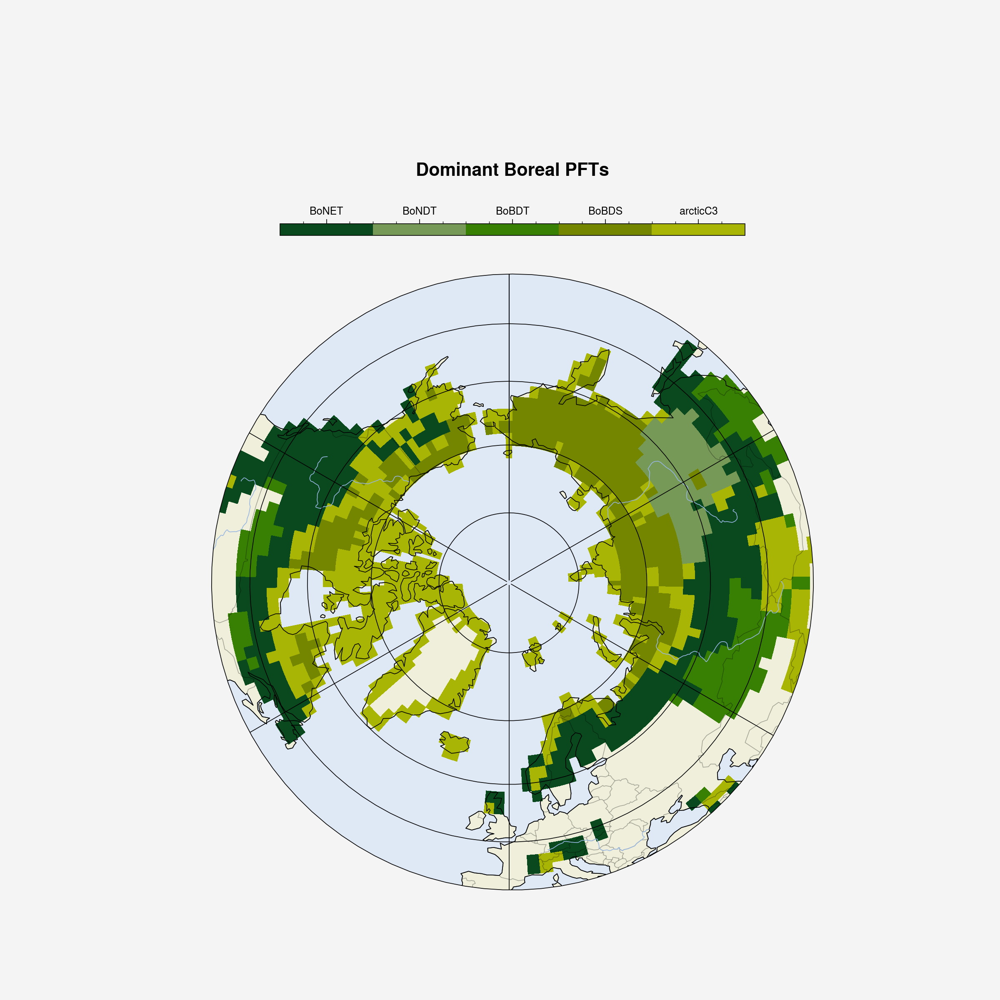

In [20]:
dominant_boreal = dominant_vegetation(boreal_pfts.where(lnd_frac>0.4), bpfts)
#dominant_boreal.plot(); plt.show()

############# Preparation for plotting:

col_dict={2:"pine green",3:"moss",8:"dark grass green",11:"swamp green",12: "mustard green"}
labels = np.array(['BoNET','BoNDT','BoBDT','BoBDS', 'arcticC3'])
cm, norm, fmt, tickz = discrete_mapping_elements(col_dict, labels)

############# Plotting:

fig = plt.figure(1, figsize=[12,12])#, dpi=300)
ax = plt.axes(projection=ccrs.Orthographic(0, 90))
circle = cut_Orthographic(lat=40)
ax.set_boundary(circle, transform=ax.transAxes) #cut at lat=35°

p= dominant_boreal.plot.pcolormesh(ax=ax, x='lon', y='lat', cmap=cm, norm=norm, transform=ccrs.PlateCarree(), 
                                add_colorbar=False) 

cb = fig.colorbar(p, ax=[ax], format=fmt, ticks=tickz, location = 'top', shrink=0.6, aspect=40)
                         
ax = ax_map_properties(ax)

plt.title("Dominant Boreal PFTs", y=1.15, size='xx-large', weight='bold')
plt.tight_layout()
plt.show()

### Comparison with other two papers
1. The Boreal Climate: https://doi.org/10.1007/978-3-642-18948-7_8
2. High latitude vegetation changes will determine future plant volatile impacts on atmospheric organic aerosols: https://doi.org/10.21203/rs.3.rs-1143422/v1

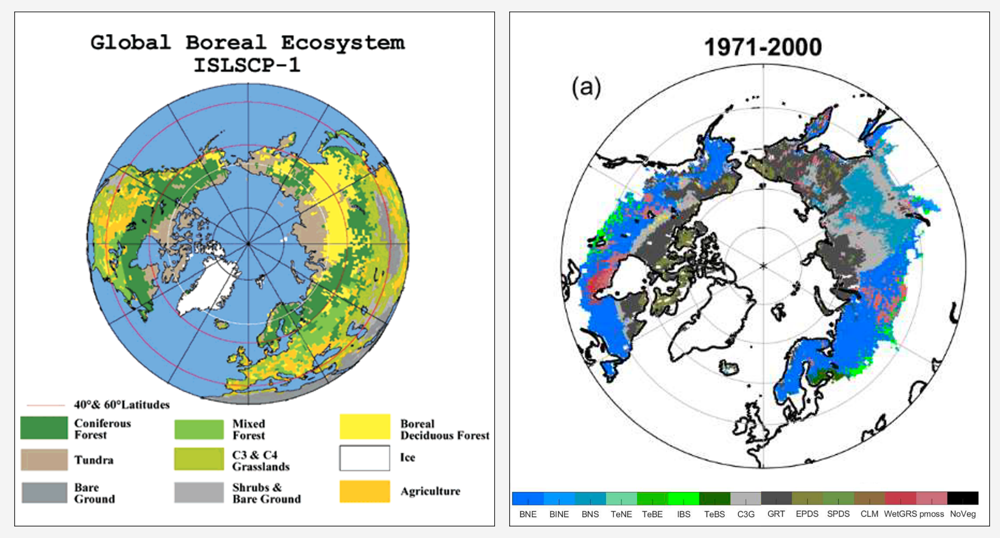

In [21]:
img_A = imread('img/boreal_ecosystems.png')
img_B = imread('img/LPJ-GUESS.png')

fig, axes = plt.subplots(1,2, figsize=[13,7])
axes[0].imshow(img_A)
axes[1].imshow(img_B)
for i in range(2):
    axes[i].grid(False)
    axes[i].set_xticks([])
    axes[i].set_yticks([])

plt.tight_layout()
plt.show()

### <div class="alert alert-info">Comments:</div>

- Default images with grid and ticks as in PlateCaree projection: `ax.grid(False)`, `ax.set_xticks([])`, `ax.set_yticks([])`.

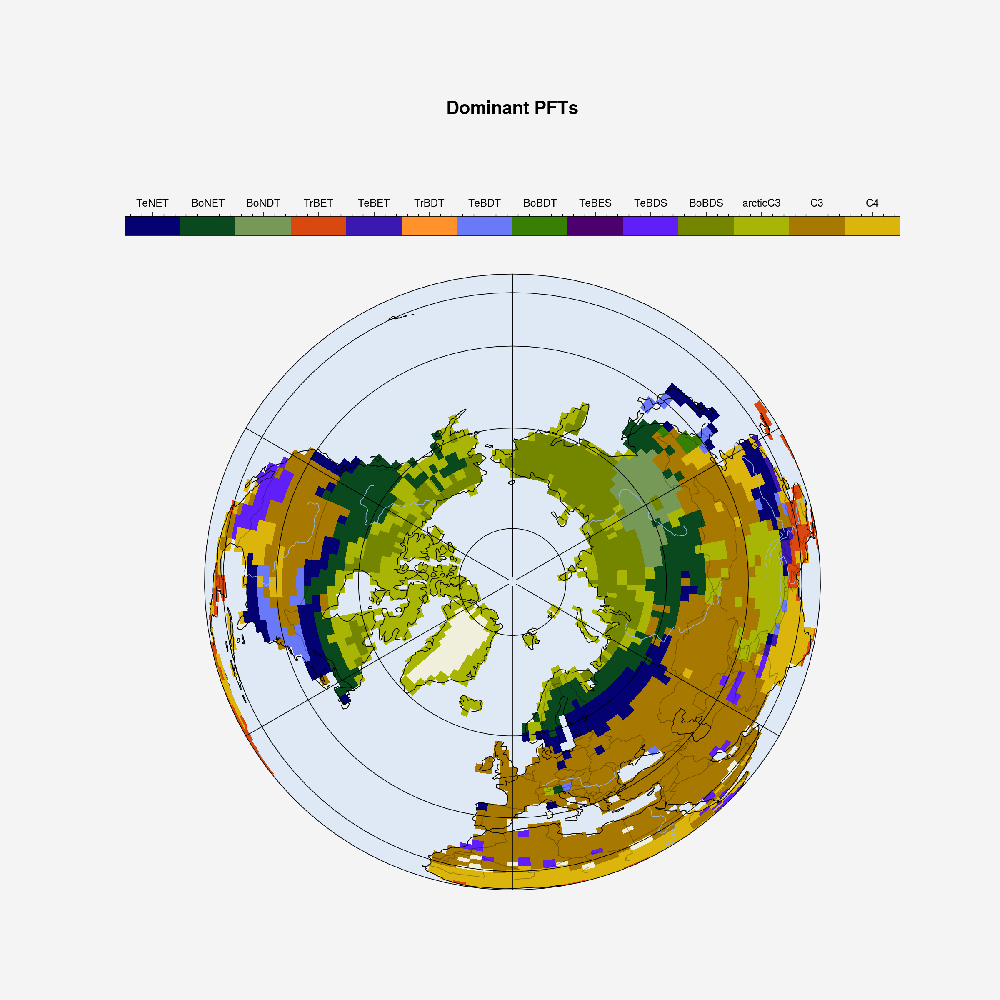

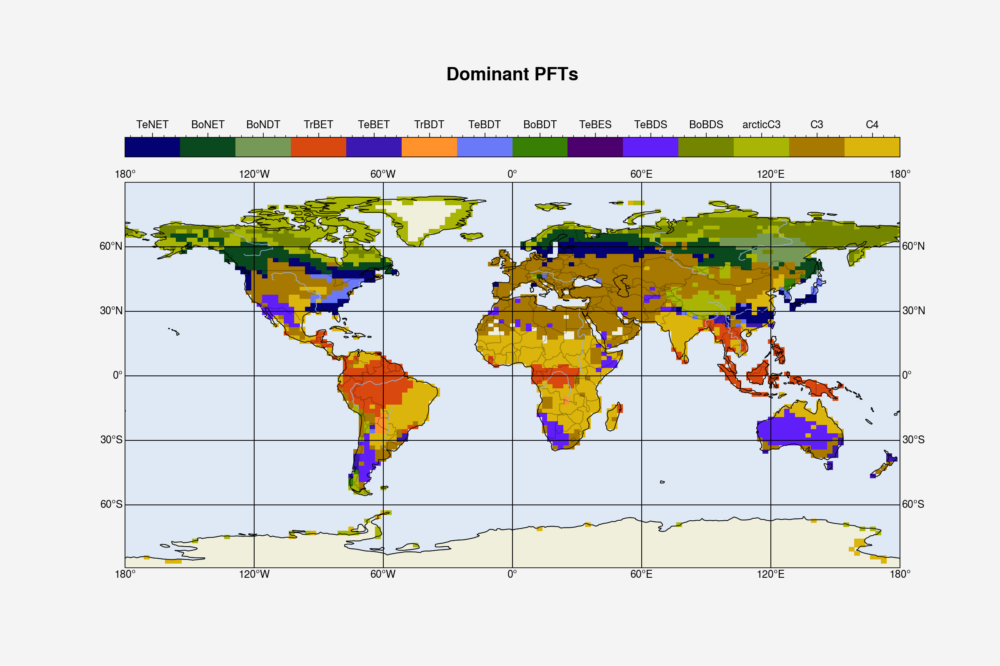

In [22]:
dominant_veg = dominant_vegetation(pfts.where(pfts.natpft>0.).where(lnd_frac>0.5), pfts.natpft) #exclude bareground
#dominant_veg.plot(); plt.show()

############# Preparation for plotting:

col_dict={1:"deep blue",2:"pine green",3:"moss", 4:"orange9", 5:"indigo blue", 
          6:"orange5", 7:"cornflower", 8:"dark grass green", 9:"royal purple", 
          10:"purple blue", 11:"swamp green", 12: "mustard green", 13:"bronze", 14:"gold"}
labels = np.array(['TeNET','BoNET','BoNDT','TrBET', 'TeBET', 'TrBDT', 'TeBDT','BoBDT','TeBES', 'TeBDS', 'BoBDS', 'arcticC3', 'C3', 'C4'])
cm, norm, fmt, tickz = discrete_mapping_elements(col_dict, labels)

############# Plotting: Orthographic
fig = plt.figure(1, figsize=[12,12]) #dpi=100
ax = plt.axes(projection=ccrs.Orthographic(0, 90))
ax.set_boundary(circle, transform=ax.transAxes) #cut at lat=35°

p= dominant_veg.plot.pcolormesh(ax=ax, x='lon', y='lat', cmap=cm, norm=norm, transform=ccrs.PlateCarree(), 
                                add_colorbar=False) 

cb = fig.colorbar(p, ax=[ax], format=fmt, ticks=tickz, location = 'top', shrink=1, aspect=40)
                         
ax = ax_map_properties(ax)

plt.title("Dominant PFTs", y=1.25, size='xx-large', weight='bold')
#plt.tight_layout()
plt.show()

############# Plotting: PlateCarree

fig = plt.figure(1, figsize=[12,8]) #dpi=100
ax = plt.axes(projection=ccrs.PlateCarree())

p= dominant_veg.plot.pcolormesh(ax=ax, x='lon', y='lat', cmap=cm, norm=norm, transform=ccrs.PlateCarree(), 
                                add_colorbar=False) 

cb = fig.colorbar(p, ax=[ax], format=fmt, ticks=tickz, location = 'top', shrink=1, aspect=40)
                         
ax = ax_map_properties(ax)
ax.gridlines(draw_labels=True)

plt.title("Dominant PFTs", y=1.25, size='xx-large', weight='bold')
#plt.tight_layout()
plt.show()

### <div class="alert alert-info">Comments:</div>
- I struggled a lot in rendering **discrete color mapping**. The code is [here](https://stackoverflow.com/questions/14777066/matplotlib-discrete-colorbar), in order to have the legend like this: discrete colors, labels that are names, not an even distant number scale. Look at the link to see all the struggles but also the possibilities that can be pursue (that I pursued...).

- [**List of possible plots with Matplotlib**](https://matplotlib.org/basemap/users/examples.html) and others are [here](https://matplotlib.org/stable/plot_types/index.html):
    - `contour()`: draw contour lines.
    - `contourf()`: draw filled contours.
    - `imshow()`: draw an image.
    - `pcolor()`: draw a pseudocolor plot.
    - `pcolormesh()`: draw a pseudocolor plot (faster version for regular meshes).
    - `plot()`: draw lines and/or markers.
    - `scatter()`: draw points with markers.
    - `quiver()`: draw vectors.
    - `barbs()`: draw wind barbs.
    - `drawgreatcircle()`: draw a great circle.
- Looking around I also found what is a **choropleth maps**: maps with colored polygons. Here the [code in Python with Ploty](https://plotly.com/python/choropleth-maps/)
- **Customize colorbar**: making it discrete, not equidistant, different palettes. [Here](https://matplotlib.org/stable/tutorials/colors/colorbar_only.html).
- Always check **Proplot** that could have the solution. [Here](https://proplot.readthedocs.io/en/stable/colors.html) are the list of the **color names**.
- Add longitude and latitude coordinates in PlateCarree projection: `ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True)`
- **Max dropping nan values**: `np.nanmax()`
- **Remove nan values from Numpy array**: `x = x[~numpy.isnan(x)]`

## <div class="alert alert-success">Digression: LANDFRAC_PFT, AREA, NAT_PFT_VEG, NAT_PFT_ABS</div>

Note: The variable PCT_NAT_PFT is a percentage of each PFT on a land unit. But the land can also not cover the whole grid cell and at the same time the area of each grid cell is not the same (the Earth is a sphere...). So in order to have the absolute ammount of PFTs we need to consider other variables: LANDFRAC_PFT (fraction of land on a grid cell, based on PFT data) and AREA (area in $m^2$ of each grid cell).

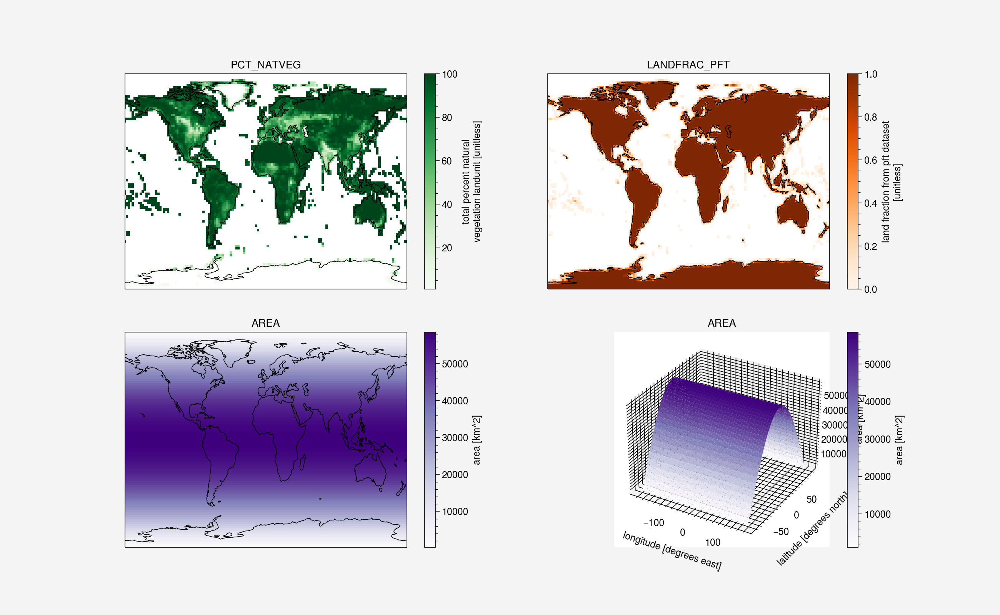

In [23]:
variables = ['PCT_NAT_PFT', 'PCT_NATVEG', 'LANDFRAC_PFT', 'AREA']
dset_pft = dset_in[variables]

fig, axes = plt.subplots(2,2,figsize=(13, 8), sharex= True, sharey=True,subplot_kw=dict(projection=ccrs.PlateCarree()))

cmaps=['Greens', 'oranges', 'purples']
#plt.tight_layout()
for i, ax in enumerate(axes.flat):
    if i<3:
        d=dset_pft.drop('PCT_NAT_PFT')[variables[i+1]]
        d.where(d>0.).plot.pcolormesh(ax=ax, cmap=cmaps[i])
        ax.set_global()
        ax.coastlines()
        ax.set_title(variables[i+1])
        ax.set_aspect('auto')
    else:
        ax=plt.subplot(224,projection='3d')
        dset_pft.AREA.plot.surface(ax=ax, cmap=cmaps[-1])
        ax.set_title(variables[-1])

#plt.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, wspace=0.05, hspace=0.07)
#plt.show()

## PCT_NAT_PFT ≠ PCT_NATVEG

**Solution**: in the BG of the PCT_NAT_PFT are included PCT_GLACIER and CROP. CROP is instead excluded in PCT_NATVEG.

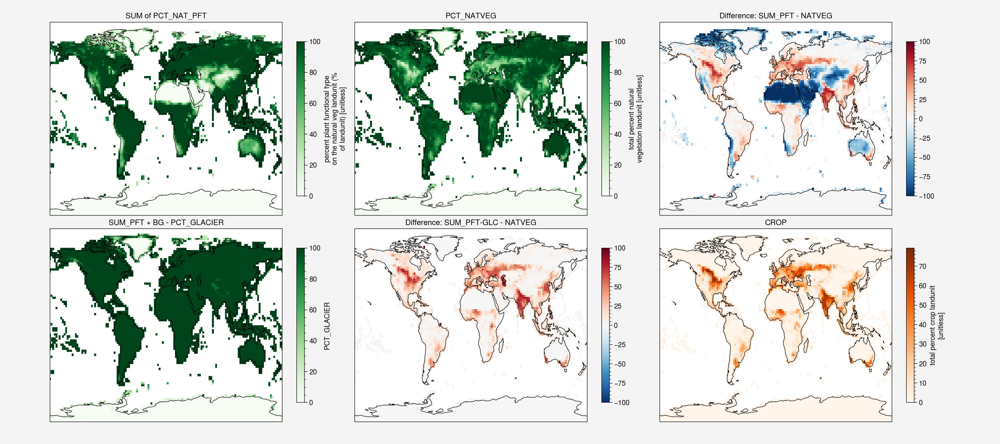

In [24]:
a = dset_in.PCT_NAT_PFT.sel(natpft=slice(1,14)).fillna(0.).sum('natpft', keep_attrs=True)
b = dset_in.PCT_NATVEG
diff=a-b
c = dset_in.PCT_NAT_PFT.fillna(0.).sum('natpft', keep_attrs=True)
d = dset_in.PCT_GLACIER
#e = dset_in.PCT_SAND.mean('nlevsoi')
diff2=100-d
diff3=diff2-b
crop=dset_in.PCT_CROP

fig, axes = plt.subplots(2,3,figsize=(18, 8), sharex= True, sharey=True, subplot_kw=dict(projection=ccrs.PlateCarree()))

plt.tight_layout()

axf=axes.flat
a.where(lnd_frac>0.).plot.pcolormesh(ax=axf[0], cmap='Greens', cbar_kwargs=dict(shrink=0.8)) #axes[0,0]
axf[0].set_title("SUM of PCT_NAT_PFT")
b.where(lnd_frac>0.).plot.pcolormesh(ax=axf[1], cmap='Greens', cbar_kwargs=dict(shrink=0.8))
axf[1].set_title("PCT_NATVEG")
diff2.where(lnd_frac>0.).plot.pcolormesh(ax=axf[3], cmap='Greens', cbar_kwargs=dict(shrink=0.8))
axf[3].set_title("SUM_PFT + BG - PCT_GLACIER")
crop.where(lnd_frac>0.).plot.pcolormesh(ax=axf[5], cmap='oranges', cbar_kwargs=dict(shrink=0.8))
axf[5].set_title("CROP")
diff.where(lnd_frac>0.).plot.pcolormesh(ax=axf[2], cmap='RdBu_r', cbar_kwargs=dict(shrink=0.8))
axf[2].set_title("Difference: SUM_PFT - NATVEG")
diff3.where(lnd_frac>0.).plot.pcolormesh(ax=axf[4], cmap='RdBu_r', cbar_kwargs=dict(shrink=0.8))
axf[4].set_title("Difference: SUM_PFT-GLC - NATVEG")

for i, ax in enumerate(axes.flat):
    ax.set_global()
    ax.coastlines()
    ax.set_aspect('auto')
    
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, wspace=0.05, hspace=0.07)

plt.show()

## From PerCenTage to ABSolute values: ABS_NAT_PFT, ABS_NATVEG

<xarray.Dataset>
Dimensions:       (natpft: 15, lat: 96, lon: 144)
Coordinates:
  * natpft        (natpft) int32 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14
  * lat           (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 86.21 88.11 90.0
  * lon           (lon) float64 -180.0 -177.5 -175.0 ... 172.5 175.0 177.5
Data variables:
    PCT_NAT_PFT   (natpft, lat, lon) float64 100.0 100.0 100.0 ... 0.0 0.0 0.0
    PCT_NATVEG    (lat, lon) float64 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    LANDFRAC_PFT  (lat, lon) float64 1.0 1.0 1.0 1.0 1.0 ... 0.0 0.0 0.0 0.0 0.0
    AREA          (lat, lon) float64 242.0 242.0 242.0 ... 242.0 242.0 242.0
    ABS_NAT_PFT   (natpft, lat, lon) float64 2.42e+04 2.42e+04 ... 0.0 0.0
    ABS_NAT_VEG   (lat, lon) float64 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
Attributes: (12/50)
    Conventions:                          NCAR-CSM
    History_Log:                          created on: 03-04-19 21:18:11
    Logname:                              erik
    Host:                                 cheyenne3
    Source:                               Community Land Model: CLM5
    Version:                              release-clm5.0.18/gpfs/fs1/scratch/...
    ...                                   ...
    map_vic_file:                         map_0.9x1.25_GRDC_to_1.9x2.5_nomask...
    Soil_texture_raw_data_file_name:      mksrf_soitex.10level.c010119.nc
    Soil_color_raw_data_file_name:        mksrf_soilcolor_CMIP6_simyr2005.c17...
    Fmax_raw_data_file_name:              mksrf_fmax_3x3min_USGS_c120911.nc
    Organic_matter_raw_data_file_name:    mksrf_organic_10level_5x5min_ISRIC-...
    Vegetation_type_raw_data_filename:    mksrf_landuse_histclm50_LUH2_2000.c...

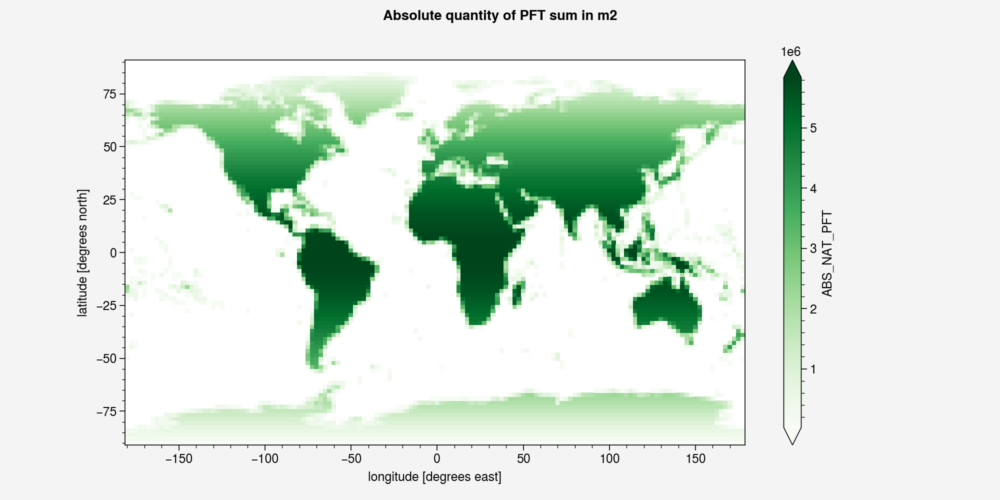

In [25]:
dset_pft['ABS_NAT_PFT']=(dset_in.PCT_NAT_PFT*dset_in.LANDFRAC_PFT*dset_in.AREA)
dset_pft['ABS_NAT_VEG']=(dset_in.PCT_NATVEG*dset_in.LANDFRAC_PFT*dset_in.AREA)
display(dset_pft)

##### For visualization:
abspft=dset_pft.ABS_NAT_PFT
abspft.sum('natpft', keep_attrs=True).where(lnd_frac>0.).plot(cmap='Greens', robust=True, figsize=[10,5])
plt.suptitle("Absolute quantity of PFT sum in m2")
plt.show()

### <div class="alert alert-info">Comments:</div>

- **select Data Variables** in Dataset: `ds[list_of_variables]`
- filter **repetition in an array**: `np.unique` or in a list `list(dict.fromkeys(mylist))`
- there problems when rendering **projections in subplots**: `tight_layout()` doesn't work --> `plt.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, wspace=0.05, hspace=0.07)`. This is the best, or you can try 'pre-poning' `tight_layout()` or change the `ax.set_aspect(2) #'auto')`
- while if I want to make all the single **axis fit in the figure**: `plt.gca().set_position([0, 0, 1, 1])`
- **projection on subplots Xarray**: `subplot_kw=dict(projection=ccrs.PlateCarree())`. This is needed then one can also add it in the singular plots: `transform=ccrs.PlateCarree()`.
- **change projection of an axis**: `ax=plt.subplot(224,projection='3d')`. Here inspiration for [3d surface maps](https://problemsolvingwithpython.com/06-Plotting-with-Matplotlib/06.16-3D-Surface-Plots/)
- **select an interval of coordinate**: `sel(natpft=slice(1,14))`
- when subplots are a multidimensional ARRAY(!):  `axes[0,0]` or **flat the axis**`axf=axes.flat` `axf[0]`. This second solution is much better if you want to change configuration/organisation of subplots.
- change attribute of colorbar: `cbar_kwargs=dict(shrink=0.8)` directly in `dset.plot()`.
- **moltiplication element by element** (simple as): `a*b` VS matrix moltiplycation: `a @ b`
- **background color on NaN values**: `ax.set_facecolor('red')`
- create support axis: `ax=plt.axes()`
- <span style="color:red">**OBS!** when `xr.sum` **ALWAYS** `keep_attrs=True`</span>
- <span style="color:red">**OBS!** when masking and summing up, **NEVER filter PRE sum - skipna=False**. But first sum and then filter.</span>

## <div class="alert alert-success">Appendix A: further analysis</div>

### Latitude distribution - Nat PFTs

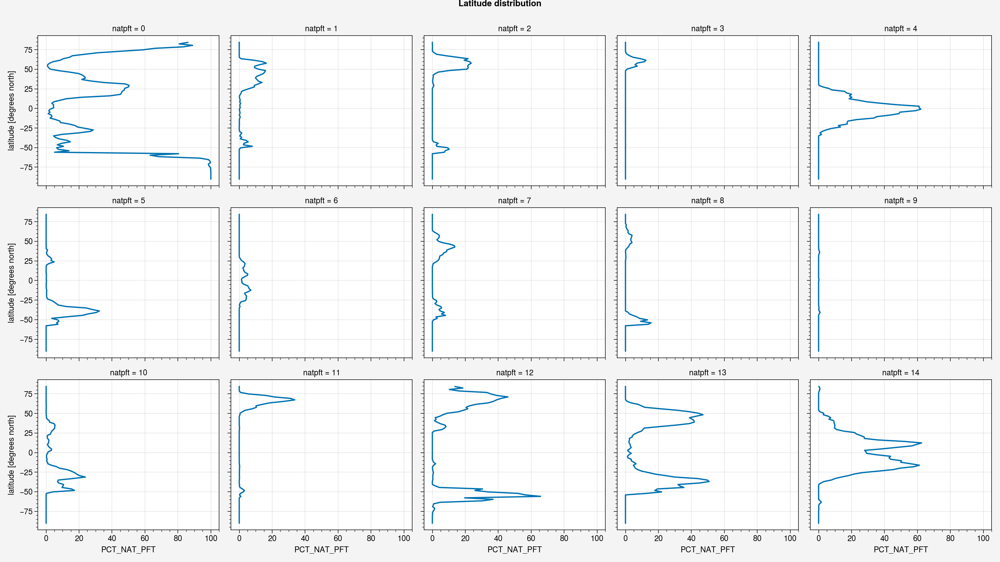

In [26]:
pfts_lat = pfts.mean('lon')
pfts_lat.plot(y='lat',col='natpft', col_wrap=5) 
#not to be influenced by the too many NaN values on the lon but it's not correct:
#.where(pfts>0.).dropna('lon', how='all') 
plt.suptitle("Latitude distribution", y=1)
plt.tight_layout()
plt.show()

### Longitude distribution - Nat PFTs

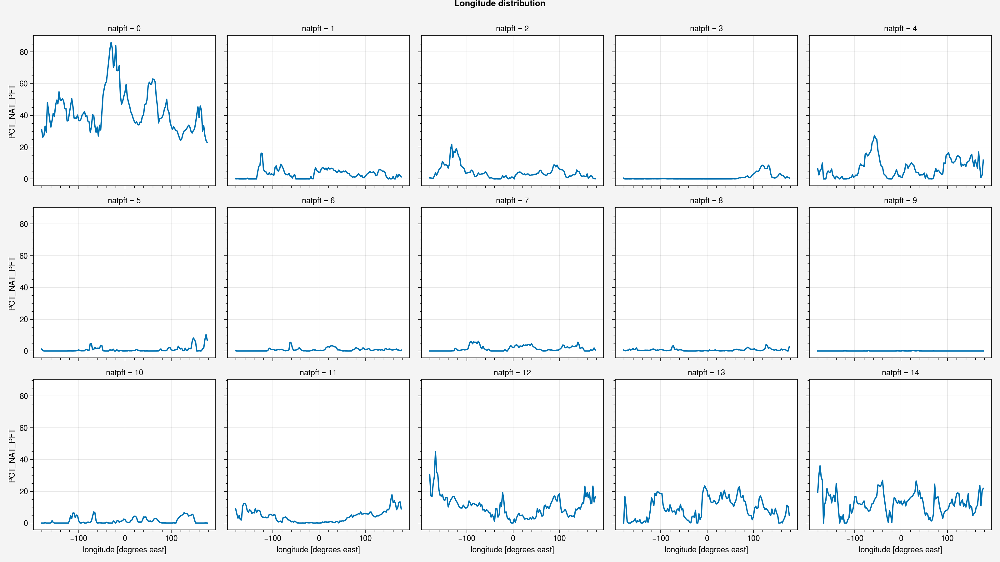

In [27]:
pfts_lon = pfts.mean('lat')
pfts_lon.plot(col='natpft', col_wrap=5)
plt.suptitle("Longitude distribution", y=1)
plt.tight_layout()
plt.show()

### ABSolute distribution of PFTs
Note: the borders are less because of the contribution of `LANDFRAC_PFT` on the single cell (so indirectly due to griding).

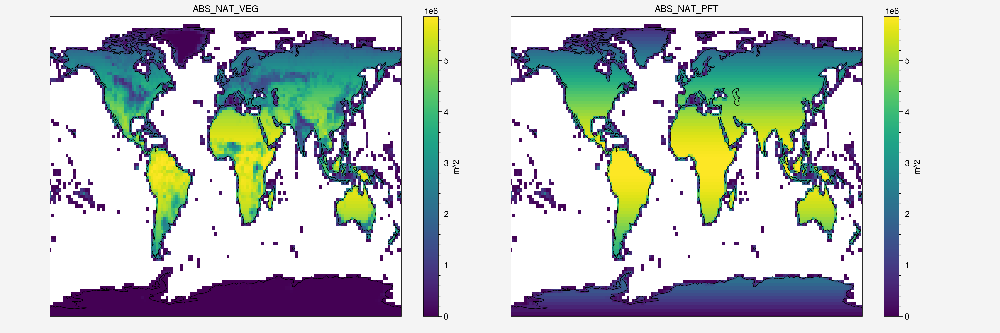

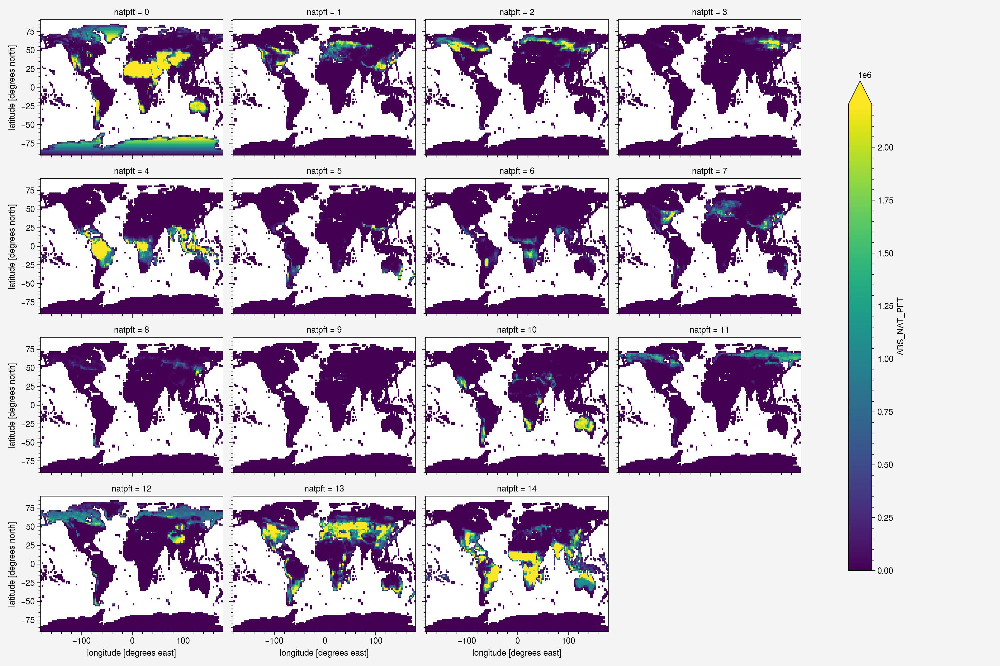

In [28]:
fig, axes = plt.subplots(1,2,figsize=(15, 5), sharex= True, sharey=True, 
                         subplot_kw=dict(projection=ccrs.PlateCarree()))
#plt.tight_layout()
dset_pft.ABS_NAT_VEG.where(lnd_frac>0.).plot(ax=axes[0], cbar_kwargs=dict(label="m^2"))
axes[0].set_title("ABS_NAT_VEG")
dset_pft.ABS_NAT_PFT.sum('natpft', keep_attrs=True).where(lnd_frac>0.).plot(ax=axes[1], cbar_kwargs=dict(label="m^2"))
axes[1].set_title("ABS_NAT_PFT")
for i, ax in enumerate(axes.flat):
    ax.set_global()
    ax.coastlines()
    ax.set_aspect('auto')

plt.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, wspace=0.05, hspace=0.07)
plt.show()

dset_pft.ABS_NAT_PFT.where(lnd_frac>0.).plot(col='natpft', col_wrap=4, robust=True, figsize=[15,10], 
                               cbar_kwargs=dict(shrink=0.8))
plt.show()

## <div class="alert alert-success">Appendix B: exploring Xarray</div>
Here are notes and code that I used to train and find my way.

### Merge several Dataset, DataArray
**NOTE:** to combine DataArrays, you need to rename the variables

In [29]:
pfts_analysis = xr.merge([pfts, pfts_lat.rename('mean_lat'), pfts_lon.rename('mean_lon')])
pfts_analysis

<xarray.Dataset>
Dimensions:      (natpft: 15, lat: 96, lon: 144)
Coordinates:
  * natpft       (natpft) int32 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14
  * lat          (lat) float64 -90.0 -88.11 -86.21 -84.32 ... 86.21 88.11 90.0
  * lon          (lon) float64 -180.0 -177.5 -175.0 -172.5 ... 172.5 175.0 177.5
Data variables:
    PCT_NAT_PFT  (natpft, lat, lon) float64 100.0 100.0 100.0 ... nan nan nan
    mean_lat     (natpft, lat) float64 100.0 100.0 99.99 100.0 ... nan nan nan
    mean_lon     (natpft, lon) float64 31.11 26.29 27.54 ... 10.9 20.23 21.93
Attributes:
    long_name:  percent plant functional type on the natural veg landunit (% ...
    units:      unitless

### Positioning specs of GridSpec
Here is a [user guide](https://matplotlib.org/stable/tutorials/intermediate/arranging_axes.html). Try to change several position to understand better.

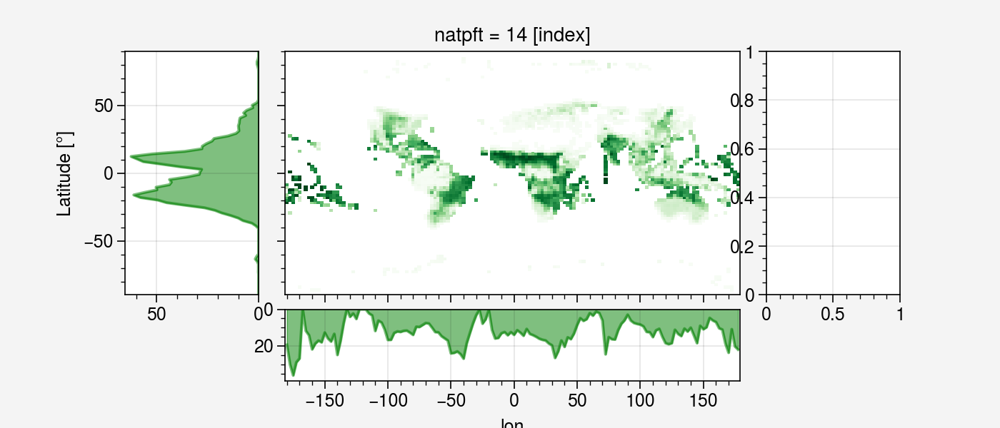

In [30]:
#pfts_lat = pfts.mean('lon')
#pfts_lon = pfts.mean('lat')

n=14
fig = plt.figure(figsize=(7, 3))
grid = plt.GridSpec(ncols=5, nrows=4, hspace=0.2, wspace=0.2)

#### Try to change here:
main_ax = fig.add_subplot(grid[:-1, 1:-1])
#######################
pfts.where(pfts>0.).sel(natpft=n).plot(ax=main_ax, add_colorbar=False, cmap='Greens')

#### Try to change here:
lat_ax = fig.add_subplot(grid[:-1, 0], sharey=main_ax, ylabel='Latitude [°]') #xticklabels=[],
##########################

df = pfts_lat.sel(natpft=n).drop('natpft').rename('Latitude [°]').to_series().rename_axis('')
base = plt.gca().transData
rot = transforms.Affine2D().rotate_deg(90)
reflect_vertical = transforms.Affine2D(np.array([[1, 0, 0], [0, -1, 0], [0, 0, 1]]))
df.plot(kind='area', ax=plt.gca(),transform= reflect_vertical + rot + base, stacked=False, color='g',xlim=(0, pfts_lat.sel(natpft=n).max()+3), ylim=(-90,90))
plt.gca().invert_xaxis()

#### Try to change here:
lon_ax = fig.add_subplot(grid[-1, 1:-1], sharex=main_ax) #yticklabels=[], 
###########################
pfts_lon.sel(natpft=n).to_series().plot(kind='area',ax=lon_ax, stacked=False, color='g', ylim=(0,pfts_lon.sel(natpft=n).max()+3))
lon_ax.invert_yaxis()

#### Try to change here:
color_ax = fig.add_subplot(grid[:-1,-1])
########################

### Mask

### <div class="alert alert-info">Comments:</div>
<span style="color:red">**OBS!** when masking and summing up, **NEVER filter PRE sum - skipna=False**. But first sum and then filter.</span>

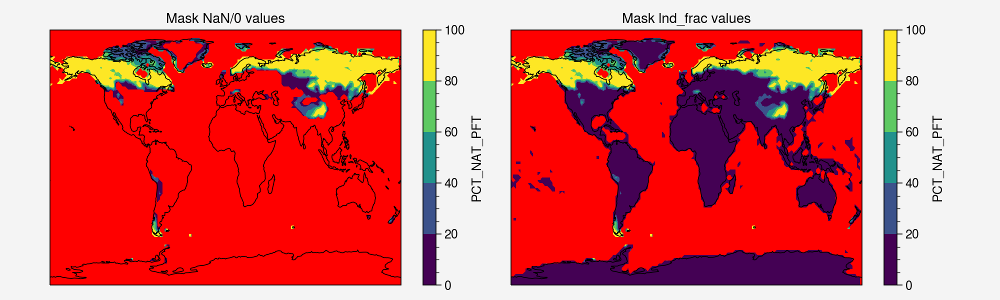

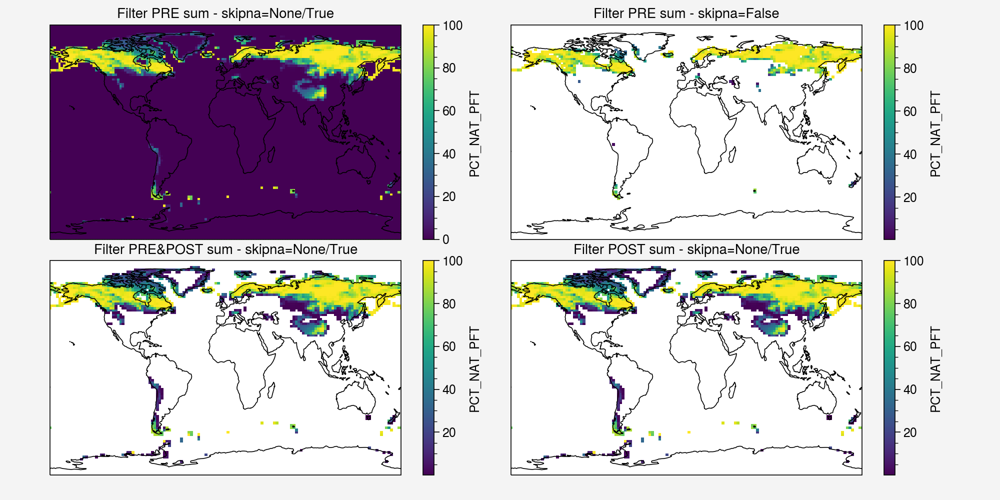

In [31]:
##### Mask NaN or 0 values ####
pfts_b=pfts.sel(natpft=bpfts)
pfts_b_mask=pfts_b.where(pfts_b>0.) #pfts_b_mask.plot(col='natpft'); plt.show()
pfts_b_sum=pfts_b.sum('natpft')

##### Mask with land fraction ####
fig, axes = plt.subplots(1,2,figsize=(10, 3), subplot_kw=dict(projection=ccrs.PlateCarree()))

pfts_b_sum.where(pfts_b_sum>0.).plot.contourf(ax=axes[0]); axes[0].set_title("Mask NaN/0 values")
pfts_b_sum.where(lnd_frac>0.).plot.contourf(ax=axes[1]); axes[1].set_title("Mask lnd_frac values")
for i, ax in enumerate(axes.flat):
    ax.set_global()
    ax.coastlines()
    ax.set_aspect('auto')
    ax.set_facecolor('red')
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.9, wspace=0.05, hspace=0.07)
plt.show()

###### xr.sum skipna=False ####
pfts_b_sumM=pfts_b_mask.sum('natpft')
pfts_b_sumF=pfts_b_mask.sum('natpft', skipna=False)
pfts_b_sumT=pfts_b_mask.sum('natpft', skipna=True)

fig, axb = plt.subplots(2,2,figsize=(10, 5), subplot_kw=dict(projection=ccrs.PlateCarree()))
axes=axb.flat
pfts_b_sumM.plot(ax=axes[0]); axes[0].set_title("Filter PRE sum - skipna=None/True")
pfts_b_sumF.plot(ax=axes[1]); axes[1].set_title("Filter PRE sum - skipna=False")
pfts_b_sumM.where(pfts_b_sumM>0.).plot(ax=axes[2]); axes[2].set_title("Filter PRE&POST sum - skipna=None/True")
pfts_b_sum.where(pfts_b_sum>0.).plot(ax=axes[3]); axes[3].set_title("Filter POST sum - skipna=None/True")
for i, ax in enumerate(axes):
    ax.set_global()
    ax.coastlines()
    ax.set_aspect('auto')
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, wspace=0.05, hspace=0.1)
plt.show()

#**OBS!** trying with Bareground, summimg up with skip_na=True, then set nan lots of more points than expected 
#--> that means that except for bareground the other natpfts have nan as values where is largely zero (like ocean).
#Good to know! skipna need to be False to avoid baised. But then where>0. (masking) need to be done later.

#pfts.isel(natpft=[0,2,3,8,11,12]).where(pfts>0.).sum('natpft', keep_attrs=True, skipna=False).plot(); plt.show()

## Exploring Xarray Dataset
### WETLAND

<span style="color:red">**OBS!** WETLAND IS NOT COMPLEMENTARY OF LANDFRANCTION</span>

WETLAND is "ON" if 100% of the grid cell is ocean.

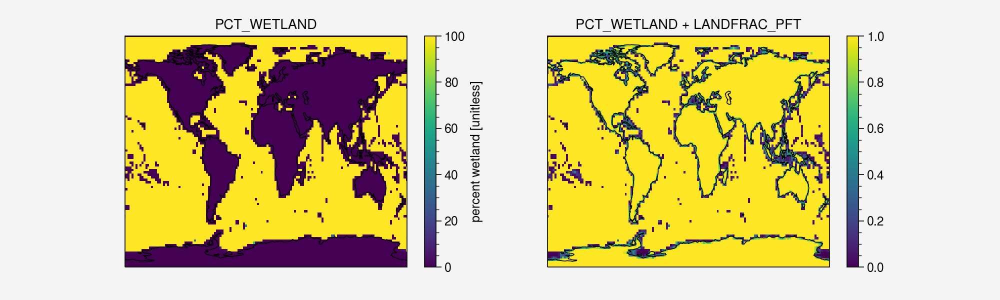

In [32]:
fig, axes = plt.subplots(1,2,figsize=(10, 3), subplot_kw=dict(projection=ccrs.PlateCarree()))
dset_in.PCT_WETLAND.plot(ax=axes[0]); axes[0].set_title("PCT_WETLAND")
dw=dset_in.PCT_WETLAND/100.+dset_in.LANDFRAC_PFT
dw.plot(ax=axes[1]); axes[1].set_title("PCT_WETLAND + LANDFRAC_PFT")
for i, ax in enumerate(axes.flat):
    ax.set_global()
    ax.coastlines()
    ax.set_aspect('auto')
plt.show()

In [33]:
# Look number values in the arrays of WETLAND and LANDFRAC
print("Values of WETLAND:", np.unique(dset_in.PCT_WETLAND).shape, ": ", np.unique(dset_in.PCT_WETLAND))
print("Values of LANDFRAC:", np.unique(dset_in.LANDFRAC_PFT).shape, ":", np.unique(dset_in.LANDFRAC_PFT))

Values of WETLAND: (17,) :  [  0.   1.   2.   4.   5.   7.   8.  22.  32.  35.  40.  68.  81.  91.
  95.  97. 100.]
Values of LANDFRAC: (2938,) : [0.00000000e+00 3.92591462e-25 9.39904515e-15 ... 1.00000001e+00
 1.00000002e+00 1.00000002e+00]


### SAND
? I dont really understand this variable: ? layers very simular, ? non-zero values in the ocean...

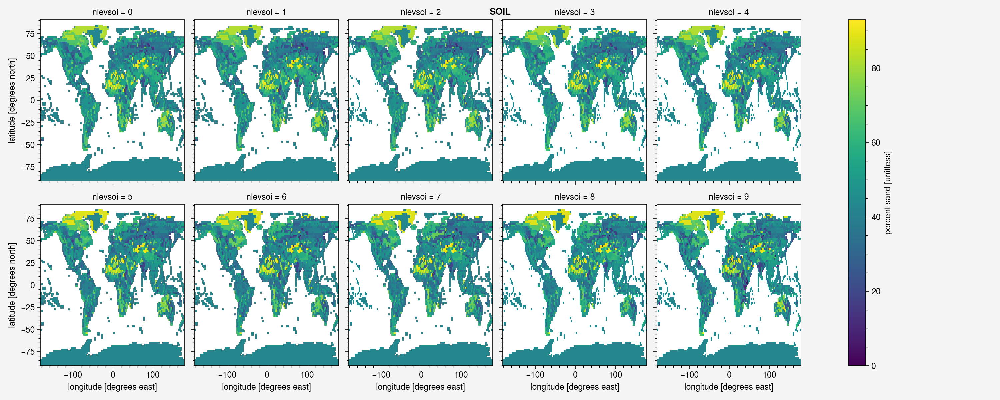

In [34]:
dset_in.PCT_SAND.where(lnd_frac>0).plot(col='nlevsoi', col_wrap=5, figsize=[15,6])
plt.suptitle("SOIL"); plt.show()

## <div class="alert alert-success">Appendix C: exploring around - basics</div>
Here are some basics

#### CMAP list
Options are: 'magma', 'inferno', 'plasma', 'viridis', 'cividis', 'twilight', 'turbo', 'blues', 'brbg', 'bugn', 'bupu', 'cmrmap', 'gnbu', 'greens', 'greys', 'orrd', 'oranges', 'prgn', 'piyg', 'pubu', 'pubugn', 'puor', 'purd', 'purples', 'rdbu', 'rdgy', 'rdpu', 'rdylbu', 'rdylgn', 'reds', 'spectral', 'wistia', 'ylgn', 'ylgnbu', 'ylorbr', 'ylorrd', 'afmhot', 'autumn', 'binary', 'bone', 'brg', 'bwr', 'cool', 'coolwarm', 'copper', 'cubehelix', 'flag', 'gist_earth', 'gist_gray', 'gist_heat', 'gist_ncar', 'gist_rainbow', 'gist_stern', 'gist_yarg', 'gnuplot', 'gnuplot2', 'gray', 'hot', 'hsv', 'jet', 'nipy_spectral', 'ocean', 'pink', 'prism', 'rainbow', 'seismic', 'spring', 'summer', 'terrain', 'winter', 'accent', 'dark2', 'paired', 'pastel1', 'pastel2', 'set1', 'set2', 'set3', 'tab10', 'tab20', 'tab20b', 'tab20c', 'blues6', 'fes', 'lapaz', 'boreal', 'browns1', 'blues7', 'lisbon', 'berlin', 'blues5', 'browns3', 'davos', 'batlowk', 'turbid', 'acton', 'browns2', 'haline', 'imola', 'batlow', 'deep', 'browns6', 'greens3', 'browns7', 'icefire', 'purples1', 'roma', 'algae', 'blues3', 'fire', 'browns5', 'greens1', 'browns4', 'blues2', 'greens8', 'reds2', 'speed', 'bamo', 'greens6', 'monocycle', 'reds3', 'cork', 'reds1', 'marine', 'lajolla', 'crest', 'tempo', 'bam', 'bamako', 'reds4', 'turku', 'thermal', 'reds5', 'glacial', 'curl', 'negpos', 'bukavu', 'oslo', 'vanimo', 'romao', 'vik', 'vlag', 'sunrise', 'sunset', 'oxy', 'delta', 'solar', 'div', 'yellows4', 'balance', 'drywet', 'rocket', 'blues4', 'matter', 'hawaii', 'yellows1', 'devon', 'ice', 'buda', 'broco', 'amp', 'yellows2', 'dusk', 'broc', 'yellows3', 'greens5', 'purples3', 'browns9', 'batloww', 'dense', 'browns8', 'purples2', 'corko', 'greens4', 'tokyo', 'oranges4', 'tofino', 'bilbao', 'phase', 'flare', 'viko', 'greens7', 'blues9', 'oranges1', 'nuuk', 'blues8', 'br', 'greens2', 'coldhot', 'oranges2', 'oleron', 'mako', 'blues1', 'oranges3', 'mono', 'stellar', 'colorblind', '538', 'classic', 'ggplot', 'qual1', 'bmh', 'qual2', 'tableau', 'default', 'colorblind10', 'flatui', 'seaborn'.

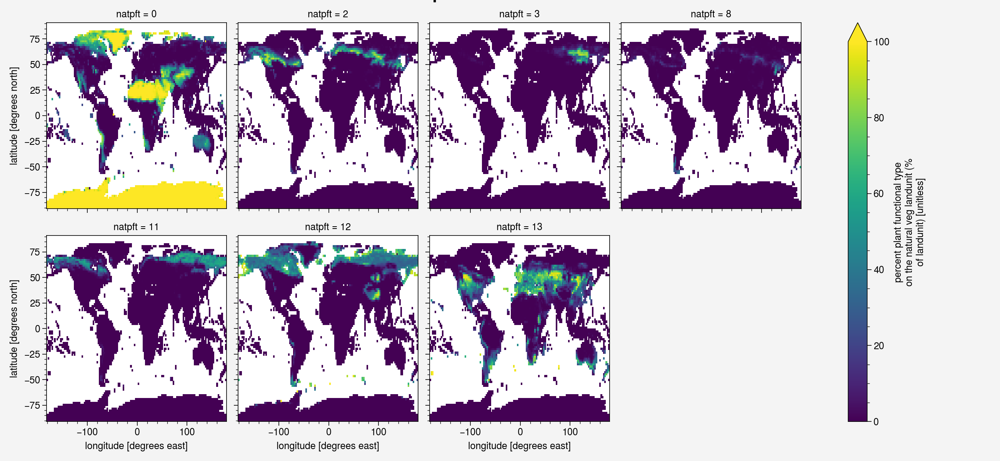

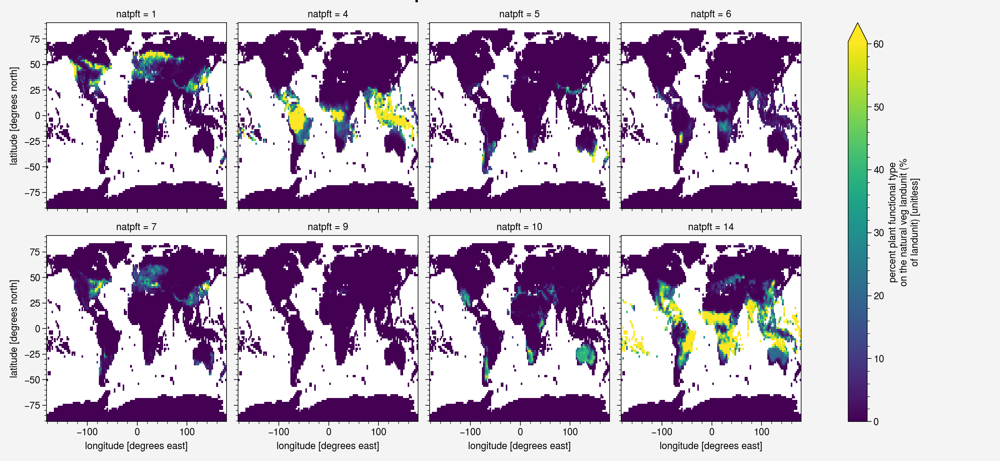

In [35]:
p = pfts.isel(natpft=[0,2,3,8,11,12,13]).plot(x='lon', y='lat', col='natpft', col_wrap=4,robust=True, cmap='viridis')
p.fig.suptitle("Expected Boreal PFTs",y=1.03, size='xx-large')
plt.show()

p= pfts.isel(natpft=[1,4,5,6,7,9,10,14]).plot(x='lon', y='lat', col='natpft', col_wrap=4,robust=True, cmap='viridis')
p.fig.suptitle("Expected non-Boreal PFTs",y=1.03, size='xx-large')
plt.show()

### Tests to find the vertical area chart

<AxesSubplot:xlabel='lat'>

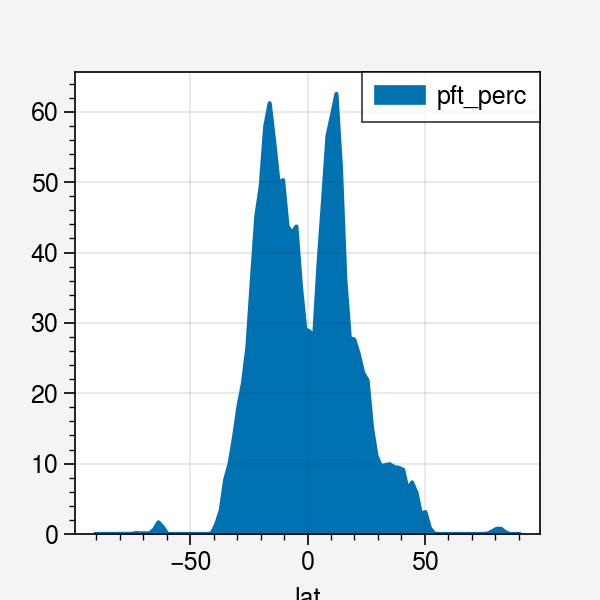

In [36]:
p = pfts_lat.sel(natpft=n).drop('natpft').rename('')#.to_series().plot(y='lat')
df = pd.DataFrame({'lat': p.lat, 'pft_perc': p.values})
#x=p.lat.values
#y2=np.zeros(len(p.values))
#y =[p.values, y2]
#plt.stackplot(y=p.lat, x=y)
df.plot.area(x='lat',y='pft_perc', figsize=[3,3])

### Maps - prettier
Change projection and mask base on latitude

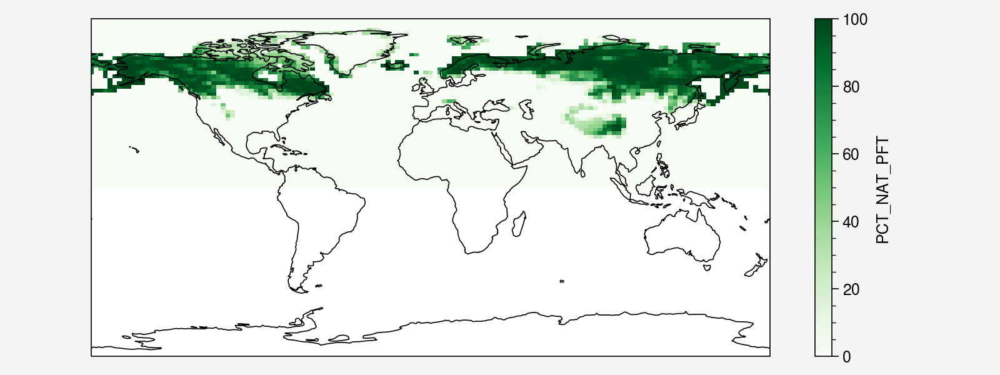

In [37]:
pfts_b_sum=pfts_b_sum.where(pfts_b_sum.lat>0)
pfts_b_mask = pfts_b_mask.where(pfts_b_mask.lat>0.)

fig = plt.figure(1, figsize=[8,3])
plt.tight_layout()
ax = plt.subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.coastlines()
pfts_b_sum.plot.pcolormesh(ax=ax, x='lon', y='lat', cmap='Greens')
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, wspace=0.05, hspace=0.1)
plt.show()

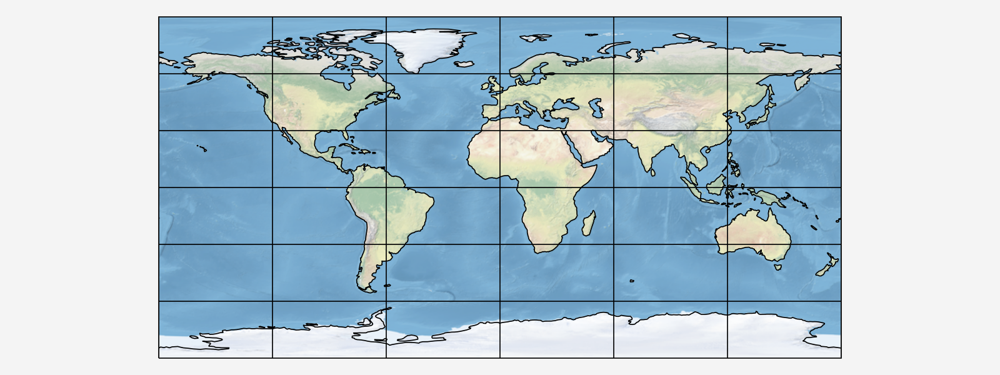

In [38]:
np.random.seed(1)
x = 360 * np.random.rand(50)
y = 180 * np.random.rand(50) - 90

fig = plt.figure(1, figsize=[8,3])#,dpi=300)
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())#central_longitude=-79))
ax.scatter(x, y,alpha=0)
ax.stock_img()
ax.coastlines()
ax.gridlines()
plt.tight_layout()
plt.show()

Here is all the code to modify the looking of the map.

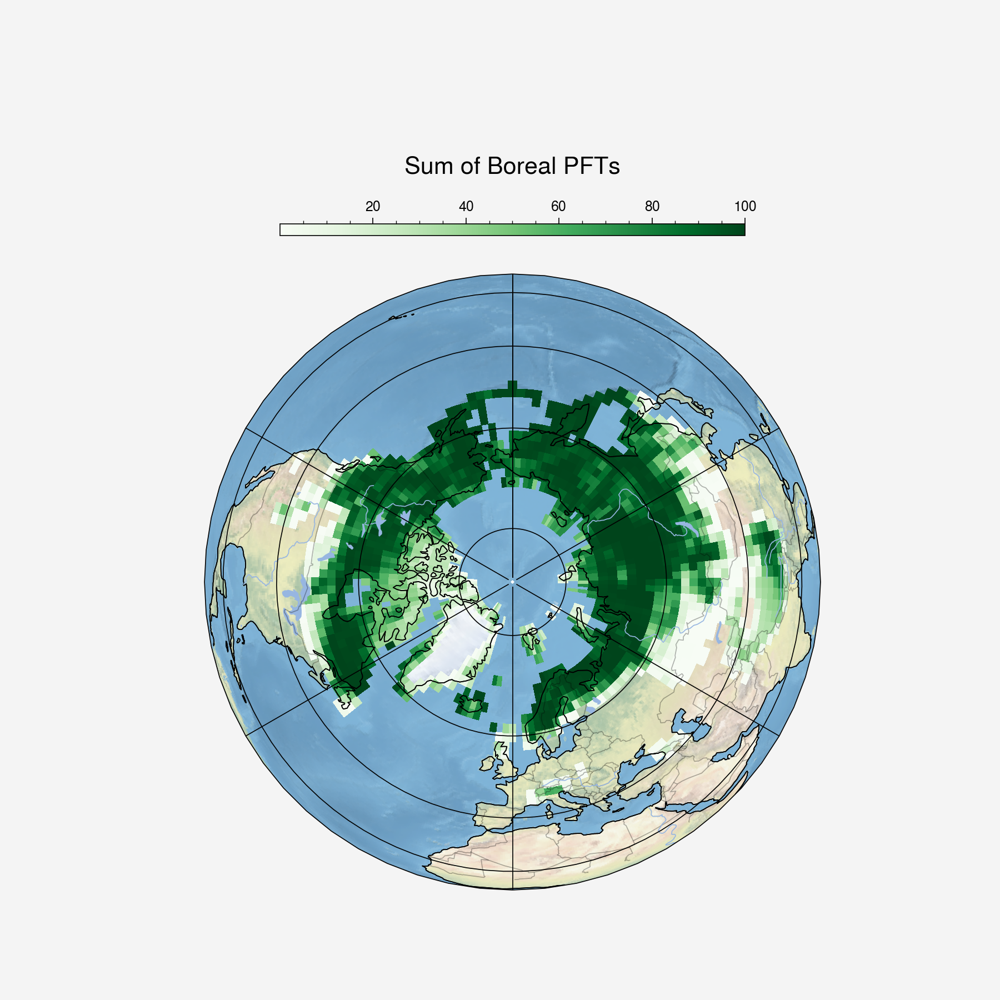

In [39]:
fig = plt.figure(1, figsize=[9,9])#,dpi=100)
provinces_50m = cfeature.NaturalEarthFeature('cultural','admin_1_states_provinces_lines','50m',
                                             facecolor='none')

ax = plt.axes(projection=ccrs.Orthographic(0, 90))

#ax.add_feature(cartopy.feature.OCEAN, zorder=0)
#ax.add_feature(cartopy.feature.LAND, zorder=0, edgecolor='black')
ax.coastlines()
ax.gridlines()

p= pfts_b_sum.where(pfts_b_sum>0.).plot.pcolormesh(ax=ax, x='lon', y='lat', cmap='Greens', vmax=100,transform=ccrs.PlateCarree(), add_colorbar=False)#, 
                         #cbar_kwargs={'orientation': 'horizontal', 'shrink':0.6, 'aspect':40})#,"pad": 1.11}) #'label':'Percent Deviation', 'extend':'both',  'fraction':0.046})
#ax.add_feature(cartopy.feature.OCEAN, zorder=0, alpha=0.3)
#ax.add_feature(cartopy.feature.LAND, zorder=0, edgecolor='black', alpha=0.3)
cbar = plt.colorbar(p,ax = [ax], location = 'top', shrink=0.6, aspect=40)

ax.add_feature(cfeature.LAKES)
#ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.BORDERS, alpha=0.3)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.RIVERS)
ax.add_feature(provinces_50m)
#fname = os.path.join('/Users/adelezaini/Downloads/NE1_50M_SR_W/', 'NE1_50M_SR_W.tif')
#ax.imshow(imread(fname), origin='upper', transform=ccrs.PlateCarree(), extent=[-180, 180, -90, 90])
url = 'http://map1c.vis.earthdata.nasa.gov/wmts-geo/wmts.cgi'
#ax.add_wmts(url, 'VIIRS_CityLights_2012')#'BlueMarble_NextGeneration')
ax.stock_img()
plt.title("Sum of Boreal PFTs", y=1.15, size='xx-large')
#plt.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, wspace=0.05, hspace=0.1)
plt.tight_layout()
plt.show()

Here instead is the pre-code before the beautiful map with the colorbar in the last axis.

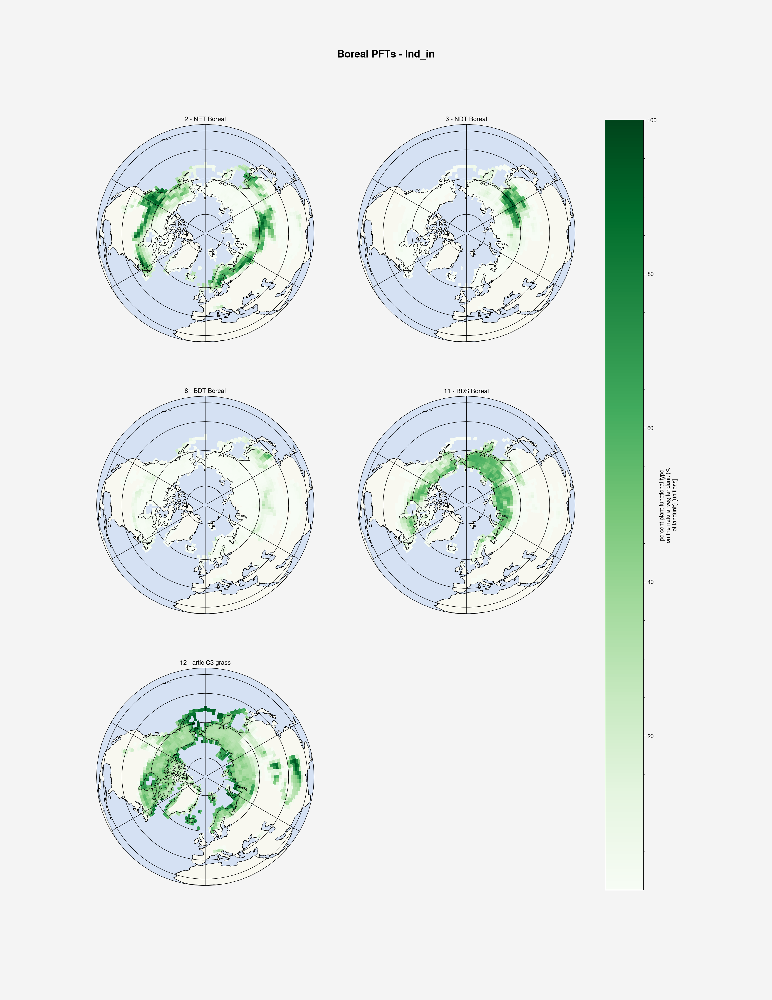

In [40]:
proj = ccrs.PlateCarree()
map_proj = ccrs.Orthographic(0, 90)

titles=['2 - NET Boreal','3 - NDT Boreal','8 - BDT Boreal','11 - BDS Boreal','12 - artic C3 grass']

p=pfts_b_mask.plot.pcolormesh(x='lon', y='lat', col='natpft', col_wrap=2,
                              cmap='Greens', transform=proj, 
                              subplot_kws={'projection':map_proj},
                              figsize=(17, 22)) #robust=True,


for i, ax in enumerate(p.axes.flat):
    ax.coastlines()
    ax.gridlines()
    ax.add_feature(cartopy.feature.OCEAN, alpha=0.4)
    ax.add_feature(cartopy.feature.LAND, edgecolor='black', alpha=0.4)
    #ax.stock_img()
    if i<5: 
        ax.set_title(titles[i])

plt.suptitle("Boreal PFTs - lnd_in", fontsize = 16, y = 0.95, fontweight = 'bold')
p.fig.tight_layout()
plt.show()

## Dominant vegetation

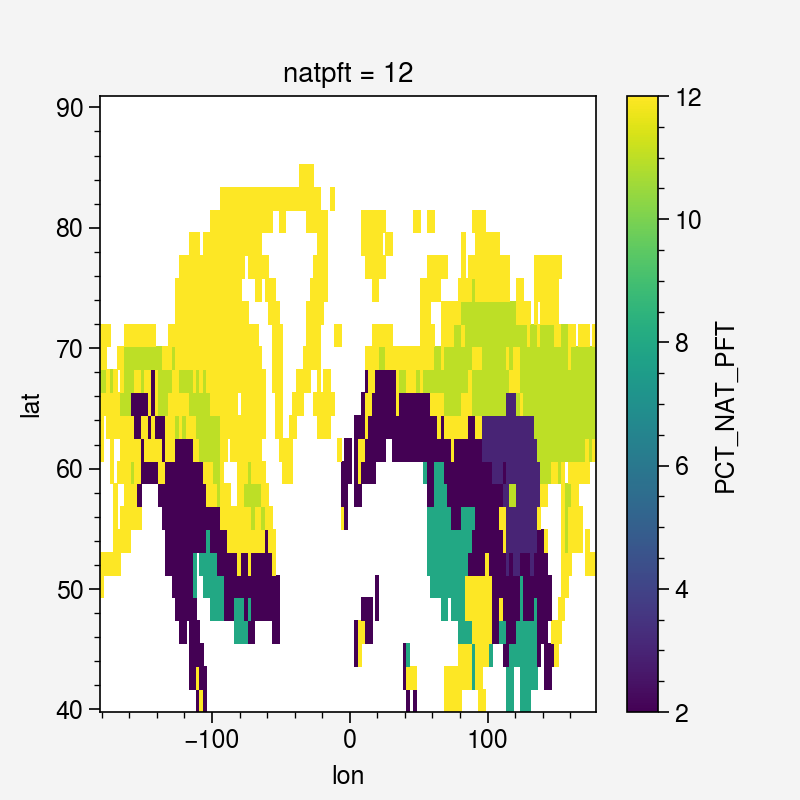

In [41]:
dominant_veg = boreal_pfts.isel(natpft=0).copy()
dominant_veg[:] = bpfts[0]
dominant_veg= dominant_veg.where(boreal_pfts_sum>0.)
#dominant_veg.plot()
#plt.show()

pfts_max = boreal_pfts.max(dim='natpft')
for bp in range(len(bpfts)):
    #print(bp, boreal_pfts[bp])
    pft_filter=boreal_pfts.sel(natpft=bpfts[bp]) == pfts_max
    dominant_veg = xr.where(pft_filter, bpfts[bp],dominant_veg)
    #dominant_veg.plot()
    plt.show()
    
dominant_veg=dominant_veg.where(boreal_pfts_sum>0.)
dominant_veg.plot()

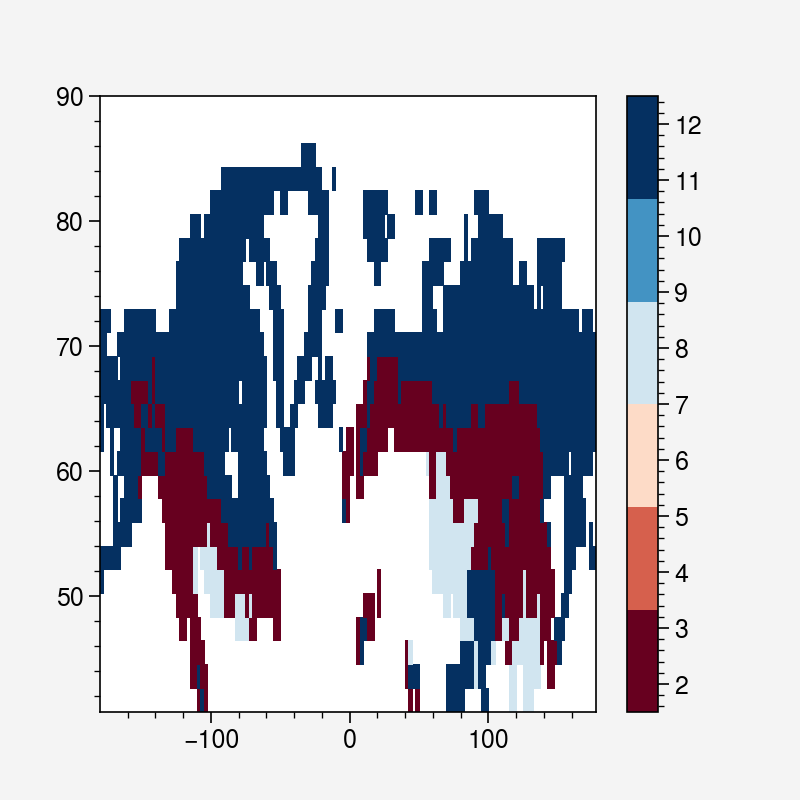

In [42]:
# Tentative to make the map discrete

def discrete_pcolor(ds, cmap='rdbu'):
    data=ds.values
    colors=np.unique(ds.values)
    colors = colors[~np.isnan(colors)]
    # get discrete colormap
    cmp = plt.get_cmap(cmap, len(colors)+1)#np.nanmax(data) - np.nanmin(data) + 1)
    # set limits .5 outside true range
    pc = plt.pcolor(ds.lon, ds.lat, data, cmap=cmp, vmin=np.nanmin(colors) - 0.5, vmax=np.nanmax(colors) + 0.5)
    # tell the colorbar to tick at integers
    cax = plt.colorbar(pc, ticks=np.arange(np.nanmin(data), np.nanmax(data) + 1))

discrete_pcolor(dominant_veg)

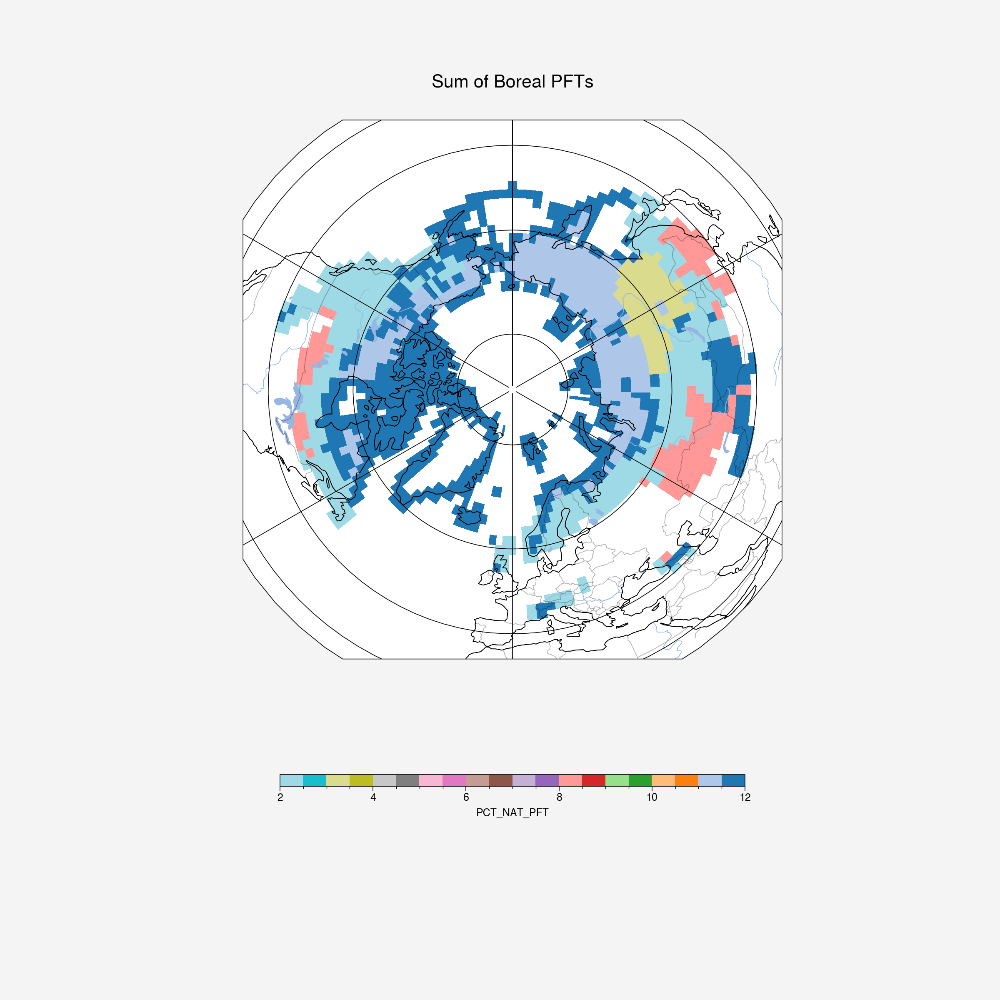

In [43]:
fig = plt.figure(1, figsize=[12,12]) #dpi=100

ax = plt.axes(projection=ccrs.Orthographic(0, 90))

ax.coastlines()
ax.gridlines()

dominant_veg.plot.pcolormesh(ax=ax, x='lon', y='lat', cmap='tab20_r', transform=ccrs.PlateCarree(),#, add_colorbar=False)#, 
                         cbar_kwargs={'orientation': 'horizontal', 'shrink':0.6, 'aspect':40})#,"pad": 1.11}) #'label':'Percent Deviation', 'extend':'both',  'fraction':0.046})
#plt.colorbar(p,ax = [ax], location = 'top', shrink=0.6, aspect=40, cmap='tab20_r')
                         
#ax.add_feature(cartopy.feature.OCEAN, zorder=0, alpha=0.3)
#ax.add_feature(cartopy.feature.LAND, zorder=0, edgecolor='black', alpha=0.3)
ax.add_feature(cfeature.LAKES)
#ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.BORDERS, alpha=0.3)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.RIVERS)
plt.title("Sum of Boreal PFTs", y=1.05, size='xx-large')
plt.tight_layout()
plt.show()

## Modify the PFTs configuration
### Idea 
1. For each PFT I find:
- a function on latitude: in order to apply the shift 

[not no function otherwise at 90° shrub can be substitute by lets say 20% as it was at 60°]
- a function on longitude:this is why there is not just one kind of trees so this can be proxy

--->? by mean? or sum then normalise, or max....

Then I create bar plots for each lat and lon I have like 20% of BET, 10% of BDT... (natpft colors)

2. apply the latitude shift.

This is a "mask" to ...

3. apply then in the close relation trees -> shrubs, shrubs -> grass, grass -> bg?

Ex: in cell 20% shrubs at 60° now, then it will be that 20% of shrubs substitute by 30% (30 of 20%) of BET (30% data by "mask")
Note: if the mask says 30%, it's the direct percentage of PFT in the "lower" cell, but it can be tuned so it is normalize to 100% let's say.

? include also temperate that substite boreal trees?

### 1. Function of latitude

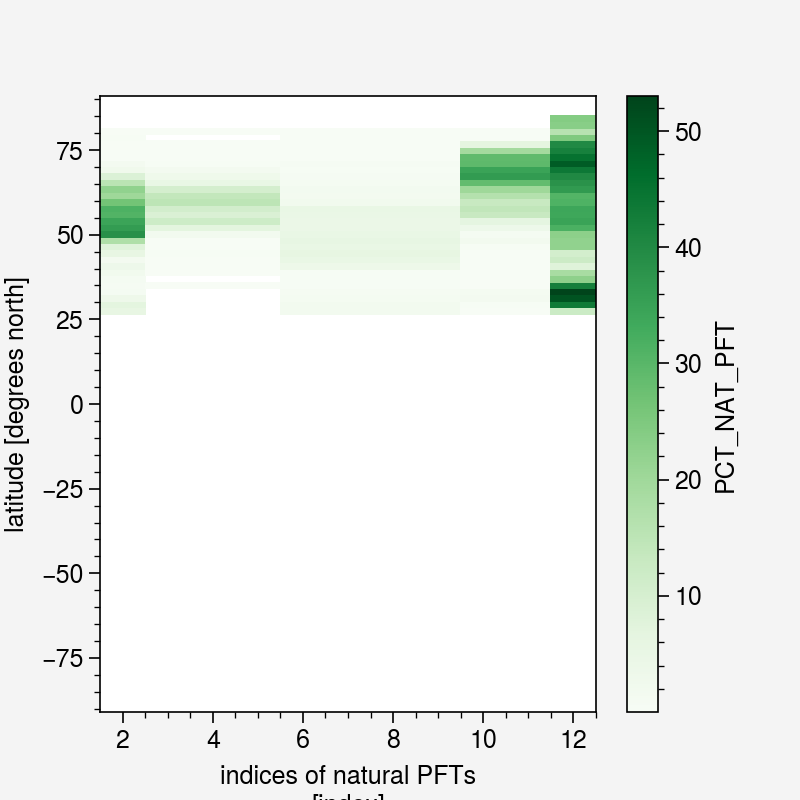

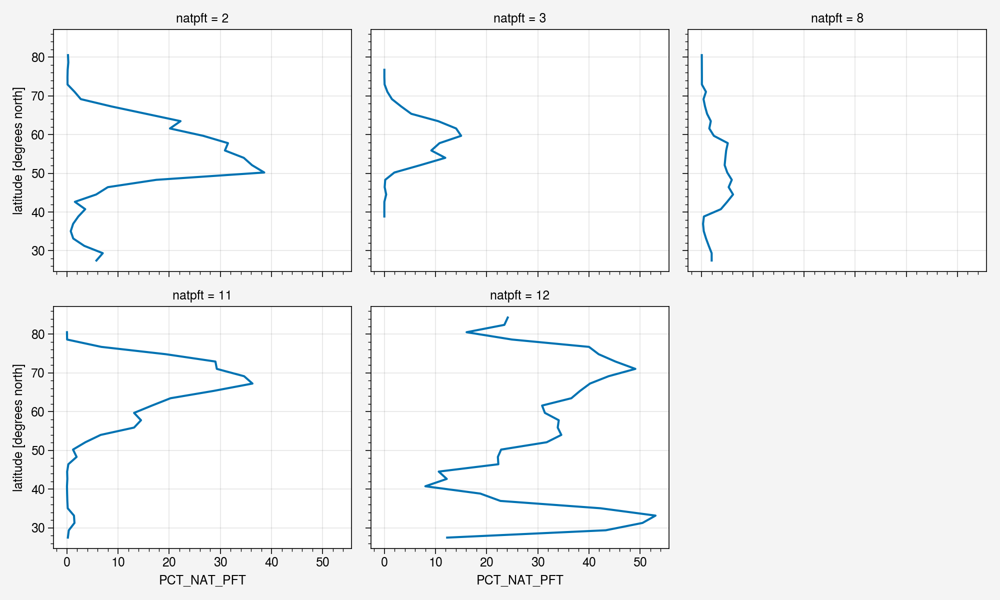

In [44]:
pfts_b_mask.mean('lon').plot(y='lat', cmap='Greens')
plt.show()
pfts_b_mask.mean('lon').plot(y='lat', col='natpft', col_wrap=3)
plt.show()

### 1. Function of latitude - polynomial fit

I filter over lat >10 deg, outside the boreal zone

**OBS!** 'dropna' and 'fillna' are very important to render well the fitting in the target lat range - outside the range the polynomial gives wierd shapes.
But 'dropna' needs to be specify how=all, because otherwise extra rows are dropped, if there is just 1! NaN values!

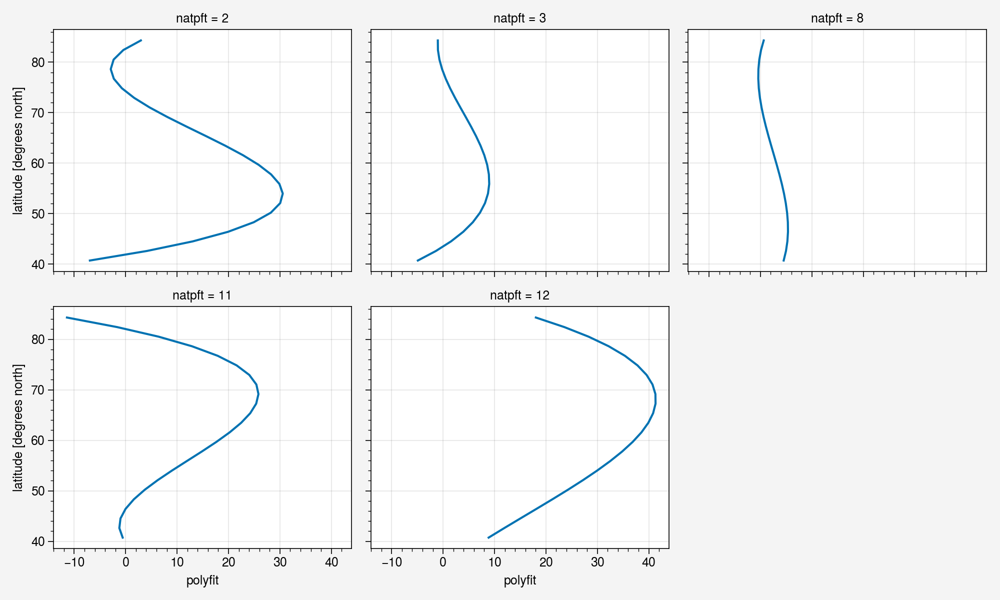

In [45]:
ds = pfts_b_mask.copy()
ds_lat=ds.mean('lon')
ds_lat = ds_lat.where(ds_lat.lat> 40.).dropna('lat', how='all').fillna(0.)
#ds_lat.plot(y='lat', col='natpft', col_wrap=3)
#plt.show()
out = ds_lat.polyfit(dim="lat", deg=3, full=True)
polyfit = xr.polyval(coord=ds_lat.lat, coeffs=out.polyfit_coefficients).rename('polyfit')
polyfit.plot(y='lat', col='natpft', col_wrap=3)
plt.show()

### 1. Function of latitude - gaussian fit
Better to render presence probability of the PFTs

**OBS**: the fitting didn't work without 'p0' (guessed parameters)

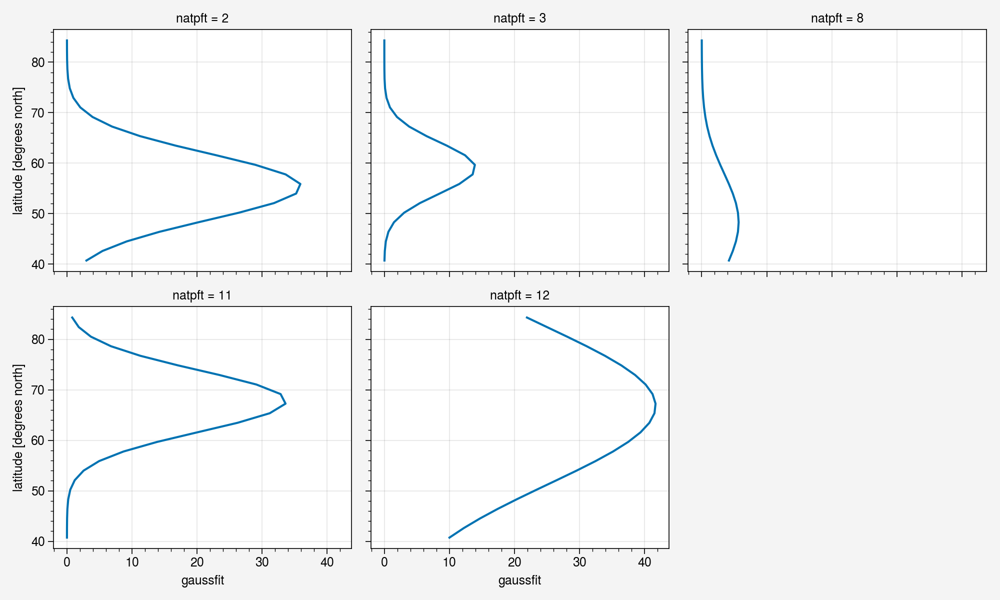

In [46]:
def gaussian(x, A, xc, sig):
    return A*np.exp(-np.power((x - xc),2.) / (2 * np.power(sig,2.)))

#ds = pfts_b_mask.copy()
#ds_lat=ds.mean('lon').dropna(dim='lat')#fillna(0.)
#ds_lat.plot(y='lat', col='natpft', col_wrap=3); plt.show()

fit_params=ds_lat.curvefit(coords='lat', func=gaussian, p0={'A':45, 'xc':55, 'sig':5})
#display(fitted)
popt=fit_params.curvefit_coefficients # NO! .values
gaussfit = gaussian(ds_lat.lat, *popt.T).drop('param').rename('gaussfit')
gaussfit.plot(y='lat',col='natpft', col_wrap=3)
plt.show()

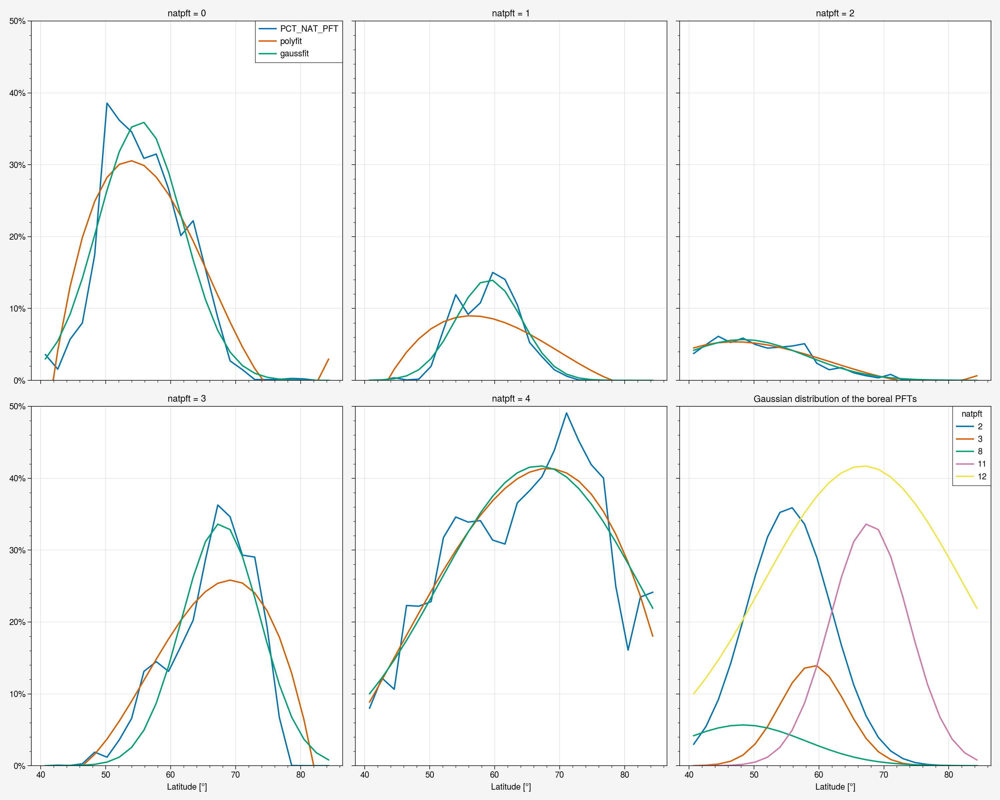

In [48]:
ds_lat = xr.merge([ds_lat, polyfit.T, gaussfit.T])#.plot.line(x='lat',col='natpft', col_wrap=3) #.rename('rawdata')

lines = ['PCT_NAT_PFT','polyfit','gaussfit']

fig, axes = plt.subplots(2, 3, figsize=[15,12], sharex=True, sharey=True)
#fig.delaxes(axes.flatten()[5])

for b, ax in enumerate(axes.flat):
    if b == 5:
        #continue
        #ax.legend(handles=lines)
        #ax.set_visible(False)
        ax.plot(ds_lat.lat, ds_lat.gaussfit)
        ax.legend(bpfts, title='natpft')#, frameon=False)
        ax.set_xlabel('Latitude [°]')
        ax.set_title("Gaussian distribution of the boreal PFTs")
    else:
        for l in lines:
            ax.plot(ds_lat.lat, ds_lat.isel(natpft= b)[l], label=l)
            ax.set_ylim(0,50)
            ax.set_yticklabels(['{0:g}%'.format(x) for x in ax.get_yticks()])
            ax.set_title('natpft = '+str(b))
            if b==3 or b==4:
                ax.set_xlabel('Latitude [°]')
            if b==0:
                ax.legend()

#fig.add_axes()
#axes.flat[-1].legend(lines)
plt.tight_layout()
#plt.legend(lines)
plt.show()

#plt.plot(ds_lat.lat, ds_lat.gaussfit)
#plt.legend(boreal_pfts)
#plt.show()

The polyfit is not appropriate, also theoretically speaking, we are looking for a probability distribution as a "bell" shape: with a peak and desending curves on the side.

Different is the point of the longitude where I need to see the avarage distribution in relation to longitude (e.g. related to land/ocean presence) --> polyfit is simple but we are aiming to make a simple model.

### 3. Apply the shift on latitude

This will be the dataset with the percentage to apply in the substitution.
**Set the latitude shift to tune the percentage.**

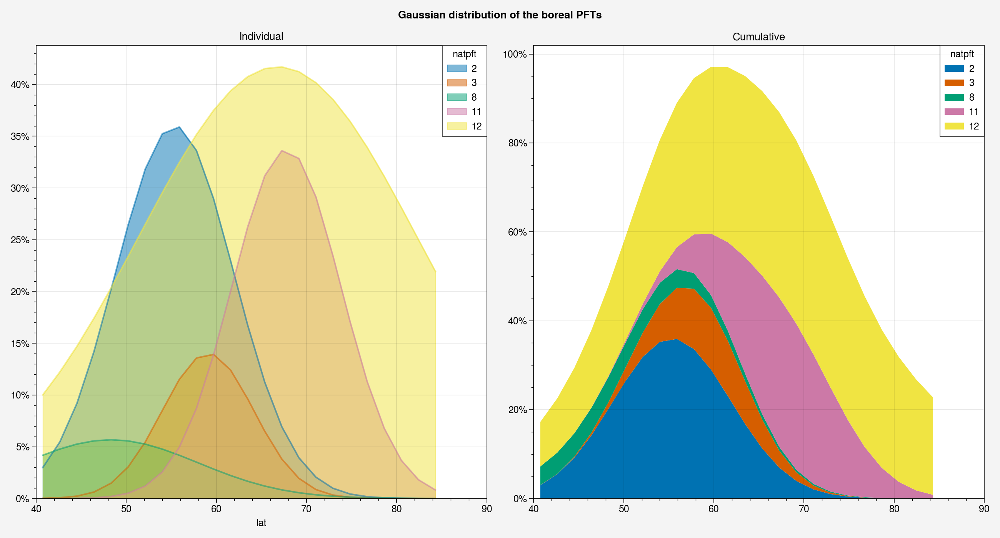

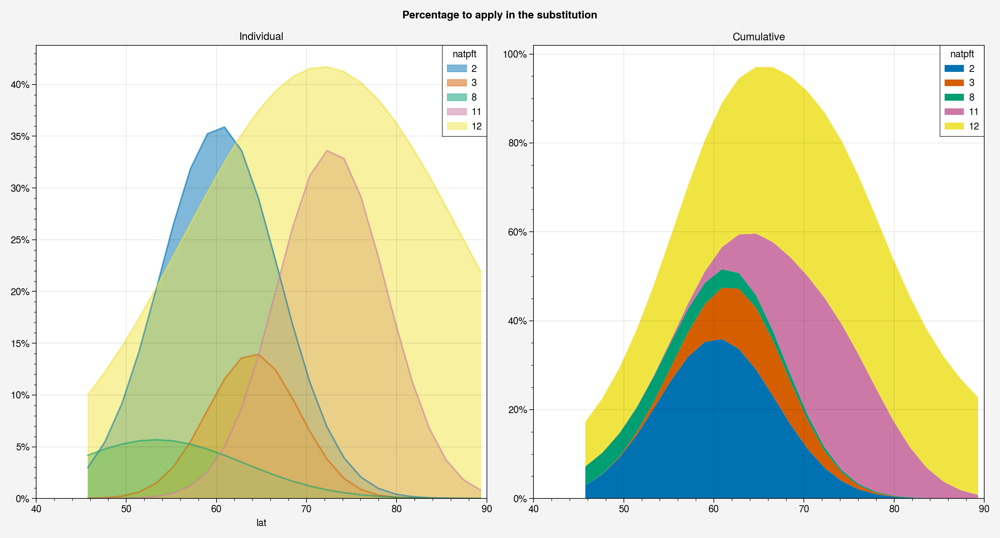

In [51]:
fig, axes = plt.subplots(1,2,figsize=(13, 7))
series = ds_lat['gaussfit'].rename('').to_series().unstack()
#series.plot.bar(ax=ax, stacked=True)
series.plot.area(ax=axes[0], stacked=False, title="Individual")

axes[1].stackplot(ds_lat.lat, ds_lat.gaussfit.T)
axes[1].legend(bpfts, title='natpft')
axes[1].set_title("Cumulative")

for b, ax in enumerate(axes.flat):
    vals = ax.get_yticks()
    ax.set_yticklabels(['{0:g}%'.format(x) for x in vals])
    ax.set_xlim(40,90)

plt.suptitle("Gaussian distribution of the boreal PFTs")

plt.tight_layout()
plt.show()

shift=5.
ds_lat_perc=ds_lat.gaussfit.rename('').copy()
ds_lat_perc=ds_lat_perc.assign_coords({'lat': ds_lat_perc.lat+shift})
#filter if the shift is too high
ds_lat_perc=ds_lat_perc.where(ds_lat_perc.lat<=90.)

fig, axes = plt.subplots(1,2,figsize=(13, 7))
series = ds_lat_perc.to_series().unstack()
#series.plot.bar(ax=ax, stacked=True)
series.plot.area(ax=axes[0], stacked=False, title="Individual")

axes[1].stackplot(ds_lat_perc.lat, ds_lat_perc.T)
axes[1].legend(bpfts, title='natpft')
axes[1].set_title("Cumulative")

for b, ax in enumerate(axes.flat):
    vals = ax.get_yticks()
    ax.set_yticklabels(['{0:g}%'.format(x) for x in vals])
    ax.set_xlim(40,90)

plt.suptitle("Percentage to apply in the substitution")

plt.tight_layout()
plt.show()

In [52]:
c = ds_lat_perc.where(ds_lat_perc==ds_lat_perc.max())
c.dropna('lat', how='all')

<xarray.DataArray '' (lat: 1, natpft: 5)>
array([[        nan,         nan,         nan,         nan, 41.69689163]])
Coordinates:
  * natpft   (natpft) int32 2 3 8 11 12
  * lat      (lat) float64 72.26

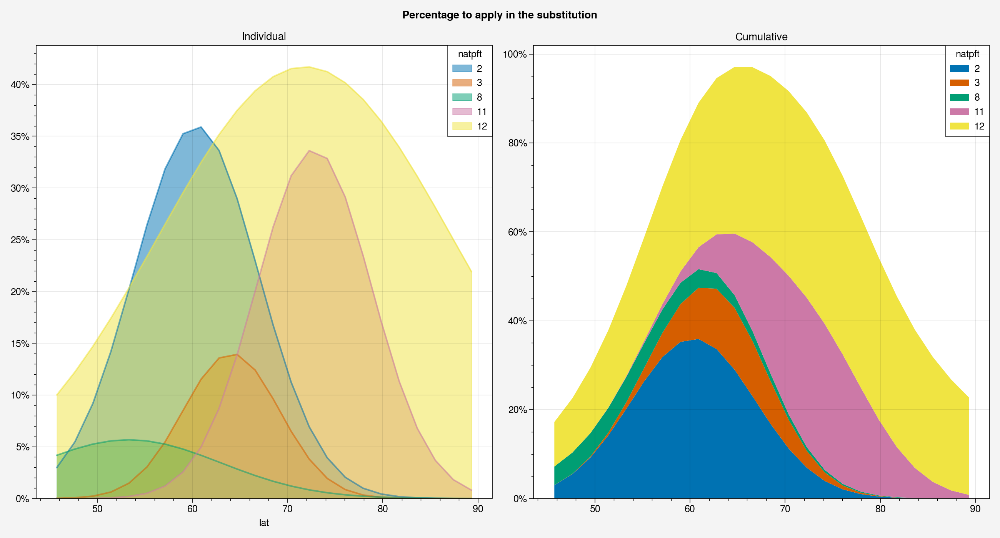

In [54]:
shift=5.
ds_lat_perc=ds_lat.gaussfit.rename('').copy()
ds_lat_perc=ds_lat_perc.assign_coords({'lat': ds_lat_perc.lat+shift})
#filter if the shift is too high
ds_lat_perc=ds_lat_perc.where(ds_lat_perc.lat<=90.)

fig, axes = plt.subplots(1,2,figsize=(13, 7))
series = ds_lat_perc.to_series().unstack()
#series.plot.bar(ax=ax, stacked=True)
series.plot.area(ax=axes[0], stacked=False, title="Individual")

axes[1].stackplot(ds_lat_perc.lat, ds_lat_perc.T)
axes[1].legend(bpfts, title='natpft')
axes[1].set_title("Cumulative")

for b, ax in enumerate(axes.flat):
    vals = ax.get_yticks()
    ax.set_yticklabels(['{0:g}%'.format(x) for x in vals])

plt.suptitle("Percentage to apply in the substitution")

plt.tight_layout()
plt.show()

Need to set percentage label for each pft
plot them separatly

### 2. Longitude function

This will be instead the percentage to apply in the decomposition within the 3 groups: trees, shrubs and grass.

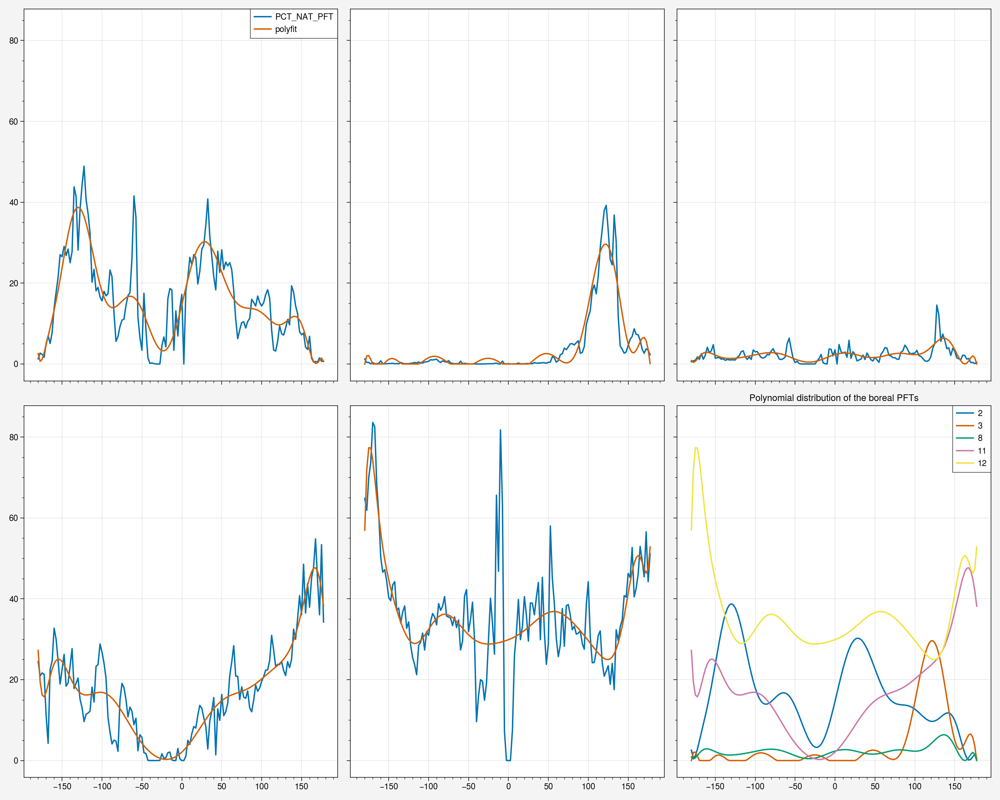

In [56]:
ds = pfts_b_mask.copy()
ds_lon=ds.mean('lat').fillna(0.)
#ds_lon.plot(col='natpft', col_wrap=3)
#plt.show()

out = ds_lon.polyfit(dim="lon", deg=15, full=True)
polyfit = xr.polyval(coord=ds_lon.lon, coeffs=out.polyfit_coefficients).rename('polyfit')
#filter negative, irrealistic values
polyfit=polyfit.where(polyfit>0., 0.)
#polyfit.plot(col='natpft', col_wrap=3)
#plt.show()

ds_lon = xr.merge([ds_lon, polyfit.T])#.plot.line(x='lat',col='natpft', col_wrap=3) #.rename('rawdata')

lines = ['PCT_NAT_PFT','polyfit']

fig, axes = plt.subplots(2, 3, figsize=[15,12], sharex=True, sharey=True)
#fig.delaxes(axes.flatten()[5])

for b, ax in enumerate(axes.flat):
    if b == 5:
        #continue
        #ax.legend(handles=lines)
        #ax.set_visible(False)
        ax.plot(ds_lon.lon, ds_lon['polyfit'].T)
        ax.legend(bpfts)
        ax.set_title("Polynomial distribution of the boreal PFTs")
    else:
        for l in lines:
            ax.plot(ds_lon.lon, ds_lon.isel(natpft= b)[l], label=l)
            #ax.set_ylim(0,90)
            if b==0:
                ax.legend()

#fig.add_axes()
#axes.flat[-1].legend(lines)
plt.tight_layout()
#plt.legend(lines)
plt.show()

### 2b. Longitude: distribution of trees

In [57]:
# BOREAL NAT PDFs:
# - 2: NET Boreal
# - 3: NDT Boreal
# - 8: BDT Boreal
# - 11: BDS Boreal
# - 12: artic C3 grass

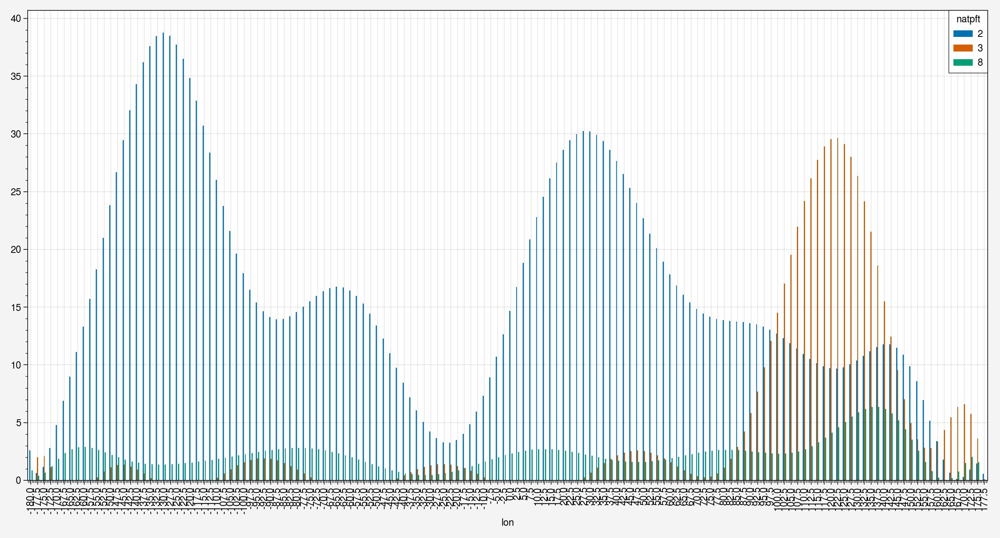

In [58]:
fig, ax = plt.subplots(figsize=(13, 7))
series = ds_lon['polyfit'].sel(natpft=[2,3,8]).T.to_series().unstack()
series.plot.bar(ax=ax)#, stacked=True)
#series.plot.area(ax=axes[0], stacked=False, title="Individual")
plt.tight_layout()
plt.show()

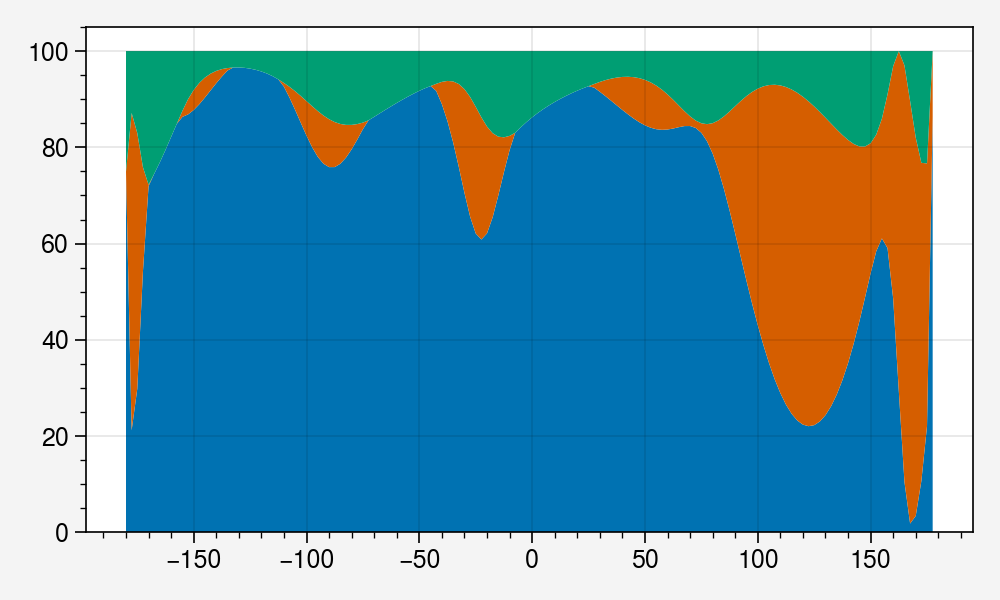

In [59]:
tree_perc= ds_lon['polyfit'].sel(natpft=[2,3,8]).rename('')
tree_perc=tree_perc/tree_perc.sum('natpft', keep_attrs=True).values*100
#tree_norm.plot.line()
fig = plt.figure(1, figsize=[5,3])
plt.stackplot(tree_perc.lon, tree_perc)
#vals = ax.get_yticks()
#plt.set_yticklabels(['{0:g}%'.format(x) for x in vals])
plt.tight_layout()
plt.show()

### 4. Substitution

Rule:
- Trees -> shrubs: [2,3,4] -> [11]
- Shrubs -> grass: [11] -> [12]
- Grass -> bg ??

1. you need to broadcast lat and lon 
2. apply to shrub perc -> substract to shrubes and add to trees..etc
3. check normalization

In [60]:
def pft_replacement(ds, shift, tune_factor):
    """
    """
    ds
    
    
    
    tpft = [2,3,8]
spft = 11
gpft = 12